In [1]:
from IPython.display import display
from IPython.display import HTML
import IPython.core.display as di # Example: di.display_html('<h3>%s:</h3>' % str, raw=True)

# This line will hide code by default when the notebook is exported as HTML
di.display_html('<script>jQuery(function() {if (jQuery("body.notebook_app").length == 0) { jQuery(".input_area").toggle(); jQuery(".prompt").toggle();}});</script>', raw=True)

# This line will add a button to toggle visibility of code blocks, for use with the HTML export version
di.display_html('''<button onclick="jQuery('.input_area').toggle(); jQuery('.prompt').toggle();">Toggle code</button>''', raw=True)


Toggle code

In [2]:
# all modules necessary for this nb
import os
import sys
import pickle
import math

import numpy as np
import pylab as pl
import scipy.stats as sstats

# setting parameters for default matplotlib plots
%matplotlib inline

In [3]:
pl.style.use('fabiostyle')
# needs to find the library of functions
sys.path.append('../../code/')  # to be replaced!

import utils as ut
import plots as pt

In [4]:
#%%javascript
#var nb = IPython.notebook;
#var kernel = IPython.notebook.kernel;
#var command = "NOTEBOOK_NAME = '" + nb.base_url + nb.notebook_path + "'";
#kernel.execute(command);

In [5]:
NOTEBOOK_NAME = 'heatmaps_dhpc_JSB'

In [6]:
from pickleshare import PickleShareDB

autorestore_folder = os.path.join(os.getcwd(), 'autorestore', NOTEBOOK_NAME)
db = PickleShareDB(autorestore_folder)
import sys
from workspace import *
import IPython
ip = IPython.get_ipython()

# this will restore all the saved variables. ignore the errors listed.
load_workspace(ip, db)

# use `save_worspace(db)` to save variables at the end

Unable to restore variable 'compute_all_dffs_JSB', ignoring (use %store -d to forget!)
('The error was:', <type 'exceptions.KeyError'>)
Unable to restore variable 'filter_cycle_JSB', ignoring (use %store -d to forget!)
('The error was:', <type 'exceptions.KeyError'>)


In [7]:
all_animals = 'dhpcg1','dhpc24','dhpc35','dhpc36','dhpcg20'
expo_animals = 'dhpcg1','dhpc24','dhpc35','dhpc36','dhpcg20'
pre_animals = 'dhpcg1','dhpc24','dhpc35','dhpc36', #,'dhpcg20' #dHPC20 performed very well on day 1 (d' = 2)
d2_animals =  'dhpcg1','dhpc24','dhpc35','dhpc36','dhpcg20'
post_animals = 'dhpcg1','dhpc24','dhpc35','dhpc36','dhpcg20'
renew_animals = 'dhpcg1','dhpc24','dhpc35','dhpc36','dhpcg20'
ext2_animals = 'dhpcg1','dhpc24','dhpc35','dhpc36','dhpcg20'
ext1_animals = 'dhpcg1','dhpc24','dhpc35','dhpc36','dhpcg20'

In [8]:
sessions = 'expo', 'pre','d2', 'post', 'ext1', 'ext2', 'renew'

In [9]:
for sess in sessions[1:]:
    exec("%s_anivars = {}"%sess)
    for animal in eval("%s_animals"%sess):
        
        exec("vars_%s = {}"%sess)
        folder = '../%s/%s/notebooks/autorestore/preprocessing/' % (animal,sess)
        for var in ('time_ax', 'time_ax_single', 'events', 'cycles', 'is_CSmt', 'is_rewardt',
                    'traces','traces_raw', 'CYCLE_START', 'CS_DURATION'): 
            eval("vars_%s"%sess).update({var:ut.load_variable(var, folder=folder)})
            
        eval("%s_anivars"%sess).update({animal:{}})
        eval("%s_anivars[animal]"%(sess)).update({eval("'vars_%s'"%sess):eval("vars_%s"%sess)})

    
    #    cellregs = dict(zip(conditions, [ut.load_cellreg_dict('../%s/data/cellreg_dict.txt' % animal, c) for c in conditions]))
    #    anivars[animal].update({'cellregs':cellregs})

In [10]:
for sess in ['expo']:
    exec("%s_anivars = {}"%sess)
    for animal in eval("%s_animals"%sess):
        exec("vars_%s = {}"%sess)
        folder = '../%s/2_odor_expo/notebooks/autorestore/preprocessing/' % (animal)
        for var in ('time_ax', 'time_ax_single', 'events', 'cycles', 'is_CSmt', 'is_rewardt',
                    'traces','traces_raw', 'CYCLE_START', 'CS_DURATION'): 
            eval("vars_%s"%sess).update({var:ut.load_variable(var, folder=folder)})
            
        eval("%s_anivars"%sess).update({animal:{}})
        eval("%s_anivars[animal]"%(sess)).update({eval("'vars_%s'"%sess):eval("vars_%s"%sess)})

### look at event amplitude

In [11]:
for sess in sessions:
    exec("all_amps_%s_CSm_evs=[]"%sess)
    exec("all_amps_%s_Rew_evs=[]"%sess)
    for animal in eval("%s_animals"%sess):
    #    cellregs = anivars[animal]['cellregs']
        exec("vars_%s = %s_anivars['%s']['vars_%s']"%(sess,sess,animal,sess))
    
        for k in eval("vars_%s.keys()"%sess):
            exec('%s = vars_%s[\'%s\']' % (k,sess,k))
    
        exec("amp_%s_CSm_evs = np.r_[[ut.compute_all_dffs(time_ax, events, cell, cycles[is_CSmt], time_ax_single)\
                        for cell in range(len(vars_%s['events'][0]))]]"%(sess,sess))
        #exec("amp_%s_CSm_evs = np.r_[[h for h in amp_%s_CSm_evs]]"%(sess,sess))
        #exec("amp_%s_CSm_evs = np.r_[[np.mean(h, 0)/np.std(h, 0) if zscored else np.mean(h, 0)/np.max(h.mean(0)) for h in amp_%s_CSm_evs]]"%(sess,sess))
        exec("amp_%s_Rew_evs = np.r_[[ut.compute_all_dffs(time_ax, events, cell, cycles[is_rewardt], time_ax_single)\
                        for cell in range(len(vars_%s['events'][0]))]]"%(sess,sess))
        #exec("amp_%s_Rew_evs = np.r_[[np.mean(h, 0)/np.std(h, 0) if zscored else np.mean(h, 0)/np.max(h.mean(0)) for h in amp_%s_Rew_evs]]"%(sess,sess))
        
        eval("all_amps_%s_CSm_evs.append(amp_%s_CSm_evs)"%(sess, sess))
        eval("all_amps_%s_Rew_evs.append(amp_%s_Rew_evs)"%(sess, sess))

#### all_amps_d2_CSm_evs[anis][cells][trials][time bins]

In [12]:
# make list of all events across all animals, cells, trials, time bins (will wanna restrict time bins to odor, trace, etc, later)
for tt in ['CSm','Rew']:
    exec("all_%s_evs=[]"%(tt))
    for sess in sessions:
        for ani in range(len(eval("all_amps_%s_%s_evs"%(sess,tt)))):
            #print i, all_amps_d2_CSm_evs[i]
            for cell in range(len(eval("all_amps_%s_%s_evs[ani]"%(sess,tt)))):
                for trial in range(len(eval("all_amps_%s_%s_evs[ani][cell]"%(sess,tt)))):
                    for tb in eval("all_amps_%s_%s_evs[ani][cell][trial]"%(sess,tt)):
                        if tb > 0.0:
                            exec("all_%s_evs.append(tb)"%(tt))

In [13]:
# make list of all events across all animals, cells, trials, time bins by session.
for tt in ['CSm','Rew']:
    for sess in sessions:
        exec("all_%s_%s_evs=[]"%(sess,tt))
        for ani in range(len(eval("all_amps_%s_%s_evs"%(sess,tt)))):
            #print i, all_amps_d2_CSm_evs[i]
            for cell in range(len(eval("all_amps_%s_%s_evs[ani]"%(sess,tt)))):
                for trial in range(len(eval("all_amps_%s_%s_evs[ani][cell]"%(sess,tt)))):
                    for tb in eval("all_amps_%s_%s_evs[ani][cell][trial]"%(sess,tt)):
                        if tb > 0.0:
                            exec("all_%s_%s_evs.append(tb)"%(sess,tt))

In [14]:
for tt in ['CSm','Rew']:
    for sess in sessions:
        print sess,tt, 'mean:',
        print np.mean(eval("all_%s_%s_evs"%(sess,tt))), 'std:',
        print np.std(eval("all_%s_%s_evs"%(sess,tt)))

expo CSm mean: 6.53892476827 std: 5.46139327396
pre CSm mean: 6.15636745531 std: 5.46186920686
d2 CSm mean: 6.23998689134 std: 5.28045868042
post CSm mean: 6.32631465032 std: 5.40196568562
ext1 CSm mean: 6.65421619905 std: 5.74457988505
ext2 CSm mean: 6.37624205566 std: 5.52339753552
renew CSm mean: 5.93668880269 std: 5.08625941072
expo Rew mean: 6.52512199962 std: 5.50535849663
pre Rew mean: 6.32385716504 std: 5.7009613002
d2 Rew mean: 6.2252683615 std: 5.35710768022
post Rew mean: 6.2214557736 std: 5.37259421869
ext1 Rew mean: 6.61888023229 std: 5.72258521635
ext2 Rew mean: 6.37286928293 std: 5.57747216073
renew Rew mean: 5.84282139636 std: 5.00107736802


In [55]:
##this takes a while
# make list of all events across all animals, cells, trials, time bins by session AND BY EPOCH.
for epoch,s,e in zip(['CS','tr','US','longUS'],[1.0,3.0,5.0,5.0],[2.0,4.0,6.0,9.0]):
    for tt in ['CSm','Rew']:
        for sess in sessions:
            print 'working on %s %s %s      '%(epoch,tt,sess),
            exec("%s_%s_%s_evs=[]"%(epoch,sess,tt))
            for ani in range(len(eval("all_amps_%s_%s_evs"%(sess,tt)))):
                for cell in range(len(eval("all_amps_%s_%s_evs[ani]"%(sess,tt)))):
                    for trial in range(len(eval("all_amps_%s_%s_evs[ani][cell]"%(sess,tt)))):
                        for tb in range(len(eval("all_amps_%s_%s_evs[ani][cell][trial]"%(sess,tt)))):
                            if eval("%s_anivars[%s_animals[ani]]['vars_%s']['time_ax_single'][tb]"%(sess,sess,sess)) >= s:
                                if eval("%s_anivars[%s_animals[ani]]['vars_%s']['time_ax_single'][tb]"%(sess,sess,sess)) <= e:
                                    if eval("all_amps_%s_%s_evs[ani][cell][trial][tb]"%(sess,tt)) > 0.0:
                                        exec("%s_%s_%s_evs.append(all_amps_%s_%s_evs[ani][cell][trial][tb])"%(epoch,sess,tt,sess,tt))

working on CS CSm expo       working on CS CSm pre       working on CS CSm d2       working on CS CSm post       working on CS CSm ext1       working on CS CSm ext2       working on CS CSm renew       working on CS Rew expo       working on CS Rew pre       working on CS Rew d2       working on CS Rew post       working on CS Rew ext1       working on CS Rew ext2       working on CS Rew renew       working on tr CSm expo       working on tr CSm pre       working on tr CSm d2       working on tr CSm post       working on tr CSm ext1       working on tr CSm ext2       working on tr CSm renew       working on tr Rew expo       working on tr Rew pre       working on tr Rew d2       working on tr Rew post       working on tr Rew ext1       working on tr Rew ext2       working on tr Rew renew       working on US CSm expo       working on US CSm pre       working on US CSm d2       working on US CSm post       working on US CSm ext1       working on US CSm ext2       working on US CSm renew  

In [56]:
for epoch in ['CS','tr','US','longUS']:
    for tt in ['CSm','Rew']:
        for sess in sessions:
            print epoch,tt,sess,'mean: ',
            print np.mean(eval("%s_%s_%s_evs"%(epoch,sess,tt)))

CS CSm expo mean:  6.09053565445
CS CSm pre mean:  6.41747264202
CS CSm d2 mean:  6.46997536241
CS CSm post mean:  6.29806790757
CS CSm ext1 mean:  7.05038677684
CS CSm ext2 mean:  6.87216678553
CS CSm renew mean:  6.43829812119
CS Rew expo mean:  6.17945593345
CS Rew pre mean:  6.30860453416
CS Rew d2 mean:  5.81701659556
CS Rew post mean:  6.08740068223
CS Rew ext1 mean:  6.56039062257
CS Rew ext2 mean:  6.43638568569
CS Rew renew mean:  5.62473302528
tr CSm expo mean:  6.21206875798
tr CSm pre mean:  5.9237559404
tr CSm d2 mean:  6.27385946178
tr CSm post mean:  6.29677264202
tr CSm ext1 mean:  6.58439214912
tr CSm ext2 mean:  6.16908713802
tr CSm renew mean:  5.85176027223
tr Rew expo mean:  6.78802976817
tr Rew pre mean:  6.11930306068
tr Rew d2 mean:  6.2326249052
tr Rew post mean:  6.06230764483
tr Rew ext1 mean:  6.59165287905
tr Rew ext2 mean:  6.32292758
tr Rew renew mean:  5.57310323861
US CSm expo mean:  7.18436289534
US CSm pre mean:  6.00074630133
US CSm d2 mean:  6.13949

## extract trace "event" durations (a.k.a. widths)

general strategy will be to crudely ID events, take mean and std of the leftover trace "baseline", then ID events more finely using the mean/std that was just defined.
event stipulations: greater than 4SD above noise (baseline std), duration is as long as it stays above 4SD. trace must be above 4SDs for at least 4 time points (to minimize false positives)
_____________________________
I didn't actually do it that way

In [7]:
##extract raw traces
#zscored = True
for sess in sessions:
    exec("all_dur_%s_CSm_raw=[]"%sess)
    exec("all_dur_%s_Rew_raw=[]"%sess)
    for animal in eval("%s_animals"%sess):
    #    cellregs = anivars[animal]['cellregs']
        exec("vars_%s = %s_anivars['%s']['vars_%s']"%(sess,sess,animal,sess))
    
        for k in eval("vars_%s.keys()"%sess):
            exec('%s = vars_%s[\'%s\']' % (k,sess,k))
    
        exec("dur_%s_CSm_raw = np.r_[[ut.compute_all_dffs(time_ax, traces_raw, cell, cycles[is_CSmt], time_ax_single)\
                        for cell in range(len(vars_%s['traces_raw'][0]))]]"%(sess,sess))
        #exec("z_dur_%s_CSm_raw = np.r_[[np.mean(h, 0)/np.std(h, 0) if zscored else np.mean(h, 0)/np.max(h.mean(0)) for h in dur_%s_CSm_raw]]"%(sess,sess))
        exec("dur_%s_Rew_raw = np.r_[[ut.compute_all_dffs(time_ax, traces_raw, cell, cycles[is_rewardt], time_ax_single)\
                        for cell in range(len(vars_%s['traces_raw'][0]))]]"%(sess,sess))
        #exec("z_dur_%s_Rew_raw = np.r_[[np.mean(h, 0)/np.std(h, 0) if zscored else np.mean(h, 0)/np.max(h.mean(0)) for h in dur_%s_Rew_raw]]"%(sess,sess))
        
        eval("all_dur_%s_CSm_raw.append(dur_%s_CSm_raw)"%(sess, sess))
        eval("all_dur_%s_Rew_raw.append(dur_%s_Rew_raw)"%(sess, sess))

In [8]:
#truncate extra time bins if necessary and collect all cells across all animals into 1 array
for sess in sessions:
    for trialtype in ('CSm','Rew'):
        exec("max_t = np.min([a.shape[2] for a in all_dur_%s_%s_raw])"%(sess,trialtype))
        exec("all_dur_%s_%s_rawA = np.row_stack([a[:,:, :max_t] for a in all_dur_%s_%s_raw])"%(sess,trialtype,sess,trialtype))
        exec("min_time_ax_single_%s = vars_%s['time_ax_single'][:max_t]"%(sess,sess))
    print max_t

48
48
48
48
48
48
48


In [9]:
##collapse all trails into same list (one for each cell)
for sess in sessions:
    for tt in ('CSm','Rew'):
        exec("all_data_by_cell_%s_%s_raw = {}"%(sess,tt))
        for cell in range(len(eval("all_dur_%s_%s_rawA"%(sess,tt)))):
            exec("all_data_by_cell_%s_%s_raw[cell] = []"%(sess,tt))
            for trial in range(len(eval("all_dur_%s_%s_rawA[cell]"%(sess,tt)))):
                for x in eval("all_dur_%s_%s_rawA[cell][trial]"%(sess,tt)):
                    exec("all_data_by_cell_%s_%s_raw[cell].append(x)"%(sess,tt))

In [24]:
##z-score the above
for sess in sessions:
    for tt in ('CSm','Rew'):
        exec("zs_all_data_by_cell_%s_%s_raw = {}"%(sess,tt))
        for cell in eval("all_data_by_cell_%s_%s_raw"%(sess,tt)):
            exec("zs_all_data_by_cell_%s_%s_raw[cell] = []"%(sess,tt))
            sd = np.std(eval("all_data_by_cell_%s_%s_raw[cell]"%(sess,tt)))
            for tb in eval("all_data_by_cell_%s_%s_raw[cell]"%(sess,tt)):
                exec("zs_all_data_by_cell_%s_%s_raw[cell].append(tb/sd)"%(sess,tt))

In [25]:
#make dictionary with tied list entries for 'event' and 'timebin'. iterate counter when a tb is above a STD threshold. if trace falls below SD thresh, reset counter
#if consecutive tbs above SD thresh are >= dur thresh, then grab the previous number of tbs equal to the value of dur_thresh and add them to the dictionary.
#continue adding new tbs/values to respective dictionary entries until trace falls below SD thresh
# can take the length of each event entry to get histogram of event durations

In [59]:
# Now extract the trace values and accompanying time bins of individual events
SD_thresh = 3
dur_thresh = 3
for sess in sessions:
    for tt in ('CSm','Rew'):
        exec("zs_extracted_%s_%s_raw = {}"%(sess,tt))  # make a dictionary; each entry is a neuron
        for cell in range(len(eval("zs_all_data_by_cell_%s_%s_raw"%(sess,tt)))):
            events=-1 # initialize the events counter for each new neuron (start at -1 so the first entry will actually be 0)
            duration_counter=0
            exec("zs_extracted_%s_%s_raw[cell] = {}"%(sess,tt))   # make a dictionary for individual events (& associated tbs)
            for tb,i in zip(eval("zs_all_data_by_cell_%s_%s_raw[cell]"%(sess,tt)),range(len(eval("zs_all_data_by_cell_%s_%s_raw[cell]"%(sess,tt))))):
                if tb >= SD_thresh: #if the zscore is higher than the SD threshold for event detection
                    duration_counter = duration_counter + 1 #increment the duration counter
                    if duration_counter == dur_thresh: #when an event crosses threshold
                        events = events+1
                        exec("zs_extracted_%s_%s_raw[cell]['event_%s'] = []"%(sess,tt,events)) #create a new dict entry for event values
                        exec("zs_extracted_%s_%s_raw[cell]['tb_%s'] = []"%(sess,tt,events)) #create a new dict entry for time bins that correspond to event values
                        for x in range(dur_thresh): #go back and populate list with values that are part of event, but prior to crossing dur_thresh
                            eval("zs_extracted_%s_%s_raw[cell]['event_%s']"%(sess,tt,events)).insert(x,
                                          eval("zs_all_data_by_cell_%s_%s_raw[cell][i-dur_thresh+x+1]"%(sess,tt)))
                            eval("zs_extracted_%s_%s_raw[cell]['tb_%s']"%(sess,tt,events)).insert(x,i-dur_thresh+x+1)
                    if duration_counter > dur_thresh: #continue to populate the list for as long as values > SD thresh
                        eval("zs_extracted_%s_%s_raw[cell]['event_%s']"%(sess,tt,events)).insert(duration_counter,tb)
                        eval("zs_extracted_%s_%s_raw[cell]['tb_%s']"%(sess,tt,events)).insert(duration_counter,i)
                    if duration_counter > 50: #if duration is super long (>6s), it's highly likely due to drifting baseline. DELETE IT
                        exec("del zs_extracted_%s_%s_raw[cell]['event_%s'][:]"%(sess,tt,events)) # delete the entry
                        exec("del zs_extracted_%s_%s_raw[cell]['tb_%s'][:]"%(sess,tt,events)) # delete the entry
                        #events = events -1 # decrement the event counter so we can overwrite this BS (and now empty) list
                        #duration_counter = 0 # reset the duration counter
                if tb < SD_thresh:
                    duration_counter = 0 # reset the duration counter

In [64]:
#extract the event durations
for sess in sessions:
    for tt in ('CSm','Rew'):
        exec("zs_durations_%s_%s_raw = []"%(sess,tt))
        for cell in range(len(eval("zs_extracted_%s_%s_raw"%(sess,tt)))):
            for event in range(len(eval("zs_extracted_%s_%s_raw[cell]"%(sess,tt)))/2):
                exec("zs_durations_%s_%s_raw.append(len(zs_extracted_%s_%s_raw[cell]['event_%s']))"%(sess,tt,sess,tt,event))

In [10]:
for sess in sessions:
    for tt in ('CSm','Rew'):
        print sess,tt,'mean:',
        print np.mean(eval("zs_durations_%s_%s_raw"%(sess,tt))), '    StDev:',
        print np.std(eval("zs_durations_%s_%s_raw"%(sess,tt)))

expo CSm mean: 7.59504950495     StDev: 5.08641904103
expo Rew mean: 7.85108531045     StDev: 5.49420649235
pre CSm mean: 6.84115319389     StDev: 5.12362878369
pre Rew mean: 6.88123167155     StDev: 5.15292243554
d2 CSm mean: 6.80055080446     StDev: 4.89743415175
d2 Rew mean: 6.75643964936     StDev: 4.89699881954
post CSm mean: 7.32434895833     StDev: 5.58475238588
post Rew mean: 6.92652921745     StDev: 5.04102783689
ext1 CSm mean: 7.18480085457     StDev: 5.20102829057
ext1 Rew mean: 7.17437874893     StDev: 5.32768128567
ext2 CSm mean: 7.35906416363     StDev: 5.75103044294
ext2 Rew mean: 7.25453806556     StDev: 5.36167808075
renew CSm mean: 7.42153846154     StDev: 5.61117646103
renew Rew mean: 7.06610995129     StDev: 5.19171222439


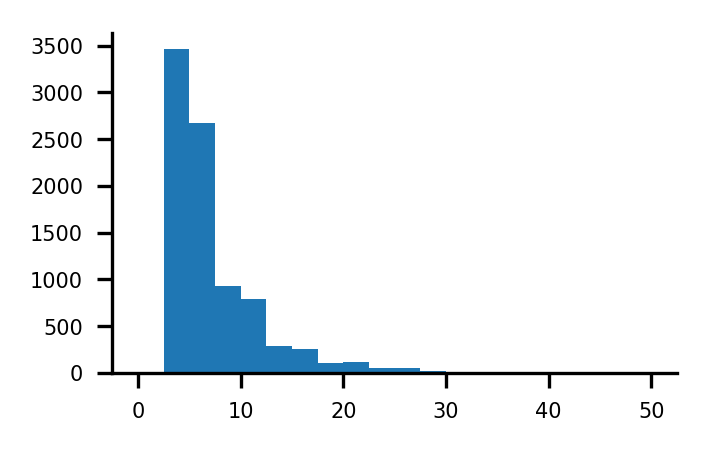

In [66]:
pl.hist(zs_durations_post_Rew_raw,bins=20)
pl.show()

In [67]:
#extract the event max values
for sess in sessions:
    for tt in ('CSm','Rew'):
        exec("zs_maxval_%s_%s_raw = []"%(sess,tt))
        for cell in range(len(eval("zs_extracted_%s_%s_raw"%(sess,tt)))):
            for event in range(len(eval("zs_extracted_%s_%s_raw[cell]"%(sess,tt)))/2):
                try:
                    exec("zs_maxval_%s_%s_raw.append(np.max(zs_extracted_%s_%s_raw[cell]['event_%s']))"%(sess,tt,sess,tt,event))
                except:
                    print 'failed on %s %s, cell: %s, event: %s'%(sess,tt,cell,event)

failed on expo CSm, cell: 183, event: 7
failed on expo CSm, cell: 183, event: 10
failed on expo Rew, cell: 183, event: 3
failed on pre CSm, cell: 235, event: 0
failed on pre CSm, cell: 304, event: 3
failed on pre Rew, cell: 235, event: 0
failed on d2 CSm, cell: 373, event: 0
failed on d2 CSm, cell: 382, event: 3
failed on d2 Rew, cell: 373, event: 2
failed on d2 Rew, cell: 551, event: 0
failed on post CSm, cell: 313, event: 0
failed on post CSm, cell: 374, event: 1
failed on post CSm, cell: 722, event: 0
failed on post Rew, cell: 313, event: 0
failed on post Rew, cell: 452, event: 0
failed on post Rew, cell: 702, event: 0
failed on post Rew, cell: 724, event: 0
failed on ext1 CSm, cell: 306, event: 0
failed on ext1 CSm, cell: 361, event: 1
failed on ext1 CSm, cell: 471, event: 0
failed on ext1 CSm, cell: 624, event: 0
failed on ext1 Rew, cell: 494, event: 0
failed on ext1 Rew, cell: 603, event: 0
failed on ext1 Rew, cell: 620, event: 0
failed on ext2 CSm, cell: 311, event: 8
failed on 

In [68]:
for sess in sessions:
    for tt in ('CSm','Rew'):
        print sess,tt,'mean:',
        print np.mean(eval("zs_maxval_%s_%s_raw"%(sess,tt))), '    StDev:',
        print np.std(eval("zs_maxval_%s_%s_raw"%(sess,tt)))

expo CSm mean: 6.08257620156     StDev: 2.18348753358
expo Rew mean: 5.99831172746     StDev: 2.1102752898
pre CSm mean: 6.93015317372     StDev: 3.07948159144
pre Rew mean: 6.72978349295     StDev: 2.90276857506
d2 CSm mean: 6.9046518773     StDev: 2.90576097925
d2 Rew mean: 6.61588440866     StDev: 2.79660338897
post CSm mean: 6.8544396846     StDev: 3.03298042813
post Rew mean: 6.42987248979     StDev: 2.89901034182
ext1 CSm mean: 6.95992256172     StDev: 3.08477677975
ext1 Rew mean: 6.86026072551     StDev: 3.07464270058
ext2 CSm mean: 6.69080973901     StDev: 2.93400045086
ext2 Rew mean: 6.5577123809     StDev: 2.8479641351
renew CSm mean: 6.8490085482     StDev: 3.09122850633
renew Rew mean: 6.46700543047     StDev: 2.93584054737


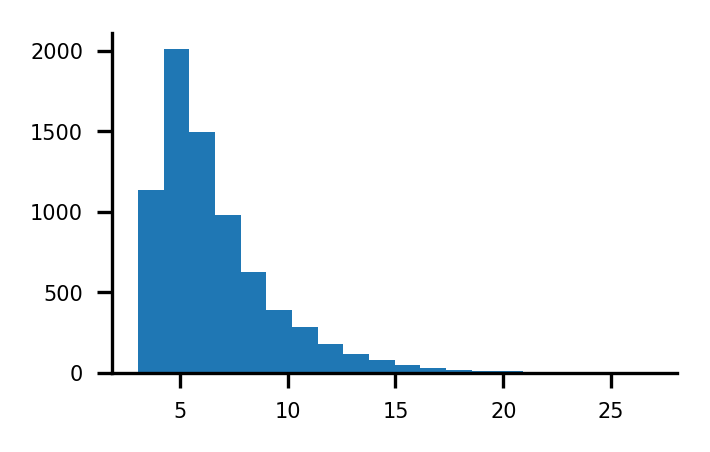

In [69]:
pl.hist(zs_maxval_d2_Rew_raw,bins=20)
pl.show()

## an alternative method for durations (where split up by time period)

#### all_dur_d2_CSm_evs[anis][cells][trials][time bins]

# make list of all events across all animals, cells, trials, time bins by session.
for tt in ['CSm','Rew']:
    for sess in sessions:
        exec("all_%s_%s_rawB=[]"%(sess,tt))
        for ani in range(len(eval("all_dur_%s_%s_rawB"%(sess,tt)))):
            #print i, all_amps_d2_CSm_rawB[i]
            for cell in range(len(eval("all_dur_%s_%s_rawB[ani]"%(sess,tt)))):
                for trial in range(len(eval("all_dur_%s_%s_rawB[ani][cell]"%(sess,tt)))):
                    for tb in eval("all_dur_%s_%s_rawB[ani][cell][trial]"%(sess,tt)):
                        if tb > 0.0:
                            exec("all_%s_%s_rawB.append(tb)"%(sess,tt))

In [15]:
##this takes a while
# make list of all events across all animals, cells, trials, time bins by session AND BY EPOCH.
SD_thresh = 1.5
dur_thresh = 3
for epoch,s,e in zip(['baseline','trial'],[-5.0,1.0],[0.0,7.0]):
    for tt in ['CSm','Rew']:
        for sess in sessions:
            cells=-1 #initialize total cell count for each new session
            print 'working on %s %s %s      '%(epoch,sess,tt),
            exec("dur_%s_%s_%s_raw={}"%(epoch,sess,tt))
            for cell in range(len(eval("zs_all_data_by_cell_%s_%s_raw"%(sess,tt)))):
                exec("dur_%s_%s_%s_raw[cell] = {}"%(epoch,sess,tt)) #initialize for all cells
            for ani in range(len(eval("all_dur_%s_%s_raw"%(sess,tt)))):
                for cell in range(len(eval("all_dur_%s_%s_raw[ani]"%(sess,tt)))):
                    cells=cells+1
                    events=-1 # initialize the events counter for each new neuron (start at -1 so the first entry will actually be 0)
                    duration_counter=0
                    for trial in range(len(eval("all_dur_%s_%s_raw[ani][cell]"%(sess,tt)))):
                        for tb,i in zip(eval("all_dur_%s_%s_raw[ani][cell][trial]"%(sess,tt)),range(len(eval("all_dur_%s_%s_raw[ani][cell][trial]"%(sess,tt))))):
                            if eval("%s_anivars[%s_animals[ani]]['vars_%s']['time_ax_single'][i]"%(sess,sess,sess)) >= s:
                                #below will allow an event's duration to continue being counted if it extends beyond the end time
                                if eval("%s_anivars[%s_animals[ani]]['vars_%s']['time_ax_single'][i]"%(sess,sess,sess)) <= e or duration_counter>1:
                                    #up to here is classifying a time bin as baseline or trial. Next apply duration criteria and extract if met
                                    if tb >= SD_thresh:
                                        duration_counter = duration_counter + 1 #increment the duration counter
                                        if duration_counter == dur_thresh: #when an event crosses threshold
                                            events = events+1
                                            exec("dur_%s_%s_%s_raw[cells]['event_%s'] = []"%(epoch,sess,tt,events)) #create a new dict entry for event values
                                            exec("dur_%s_%s_%s_raw[cells]['tb_%s'] = []"%(epoch,sess,tt,events)) #create a new dict entry for time bins that correspond to event values
                                            for x in range(dur_thresh): #go back and populate list with values that are part of event, but prior to crossing dur_thresh
                                                eval("dur_%s_%s_%s_raw[cells]['event_%s']"%(epoch,sess,tt,events)).insert(x,
                                                      eval("all_dur_%s_%s_raw[ani][cell][trial][i-dur_thresh+x+1]"%(sess,tt)))
                                                eval("dur_%s_%s_%s_raw[cells]['tb_%s']"%(epoch,sess,tt,events)).insert(x,i-dur_thresh+x+1)
                                        if duration_counter > dur_thresh: #continue to populate the list for as long as values > SD thresh
                                            eval("dur_%s_%s_%s_raw[cells]['event_%s']"%(epoch,sess,tt,events)).insert(duration_counter,tb)
                                            eval("dur_%s_%s_%s_raw[cells]['tb_%s']"%(epoch,sess,tt,events)).insert(duration_counter,i)
                                        if duration_counter > 50: #if duration is super long (>6s), it's highly likely due to drifting baseline. DELETE IT
                                            exec("del dur_%s_%s_%s_raw[cells]['event_%s'][:]"%(epoch,sess,tt,events)) # delete the entry
                                            exec("del dur_%s_%s_%s_raw[cells]['tb_%s'][:]"%(epoch,sess,tt,events)) # delete the entry
                                            #events = events -1 # decrement the event counter so we can overwrite this BS (and now empty) list
                                            #duration_counter = 0 # reset the duration counter
                                    if tb < SD_thresh:
                                        duration_counter = 0 # reset the duration counter
                                else:
                                    duration_counter = 0
                            else:
                                duration_counter = 0

working on baseline expo CSm       working on baseline pre CSm       working on baseline d2 CSm       working on baseline post CSm       working on baseline ext1 CSm       working on baseline ext2 CSm       working on baseline renew CSm       working on baseline expo Rew       working on baseline pre Rew       working on baseline d2 Rew       working on baseline post Rew       working on baseline ext1 Rew       working on baseline ext2 Rew       working on baseline renew Rew       working on trial expo CSm       working on trial pre CSm       working on trial d2 CSm       working on trial post CSm       working on trial ext1 CSm       working on trial ext2 CSm       working on trial renew CSm       working on trial expo Rew       working on trial pre Rew       working on trial d2 Rew       working on trial post Rew       working on trial ext1 Rew       working on trial ext2 Rew       working on trial renew Rew      


In [16]:
#extract the event durations
for sess in sessions:
    for tt in ('CSm','Rew'):
        for epoch in 'baseline','trial':
            exec("zs_durations_%s_%s_%s_rawB = []"%(epoch,sess,tt))
            for cell in range(len(eval("dur_%s_%s_%s_raw"%(epoch,sess,tt)))):
                for event in range(len(eval("dur_%s_%s_%s_raw[cell]"%(epoch,sess,tt)))/2):
                    exec("zs_durations_%s_%s_%s_rawB.append(len(dur_%s_%s_%s_raw[cell]['event_%s']))"%(epoch,sess,tt,epoch,sess,tt,event))

In [17]:
for sess in sessions:
    for tt in ('CSm','Rew'):
        for epoch in 'baseline','trial':
            print sess,tt,epoch,'mean:',
            print np.mean(eval("zs_durations_%s_%s_%s_rawB"%(epoch,sess,tt))), '    StDev:',
            print np.std(eval("zs_durations_%s_%s_%s_rawB"%(epoch,sess,tt)))

expo CSm baseline mean: 13.189784236     StDev: 13.0063528662
expo CSm trial mean: 10.5866881374     StDev: 7.92543585401
expo Rew baseline mean: 12.3137502632     StDev: 12.243635672
expo Rew trial mean: 10.4801945796     StDev: 7.86043503109
pre CSm baseline mean: 10.4815434965     StDev: 10.4166941801
pre CSm trial mean: 8.52651664693     StDev: 6.53640746651
pre Rew baseline mean: 10.2520490262     StDev: 10.3622235666
pre Rew trial mean: 8.57477313975     StDev: 6.45967565614
d2 CSm baseline mean: 10.2388493476     StDev: 10.2847684592
d2 CSm trial mean: 8.62248110831     StDev: 6.71869442684
d2 Rew baseline mean: 10.5560461557     StDev: 10.5545215151
d2 Rew trial mean: 9.01003758933     StDev: 6.65380678514
post CSm baseline mean: 11.1471371157     StDev: 11.2821970453
post CSm trial mean: 9.05754269874     StDev: 7.0092201211
post Rew baseline mean: 11.2719413152     StDev: 11.437242332
post Rew trial mean: 9.55154795119     StDev: 6.91746311033
ext1 CSm baseline mean: 11.16526

In [ ]:
np.mean(zs_durations_trial_post_Rew_rawB[0])

In [ ]:
np.mean(zs_durations_trial_post_Rew_rawB[0][0])

In [ ]:
len(zs_durations_trial_post_Rew_rawB[0])

### get data for heatmaps

In [71]:
zscored = True

for sess in sessions:
    exec("all_hms_%s_CSm_evs=[]"%sess)
    exec("all_hms_%s_Rew_evs=[]"%sess)
    for animal in eval("%s_animals"%sess):
    #    cellregs = anivars[animal]['cellregs']
        exec("vars_%s = %s_anivars['%s']['vars_%s']"%(sess,sess,animal,sess))
    
        for k in eval("vars_%s.keys()"%sess):
            exec('%s = vars_%s[\'%s\']' % (k,sess,k))
    
        exec("hm_%s_CSm_evs = np.r_[[ut.compute_all_dffs(time_ax, events, cell, cycles[is_CSmt], time_ax_single)\
                        for cell in range(len(vars_%s['events'][0]))]]"%(sess,sess))
        exec("hm_%s_CSm_evs = np.r_[[np.mean(h, 0)/np.std(h, 0) if zscored else np.mean(h, 0)/np.max(h.mean(0)) for h in hm_%s_CSm_evs]]"%(sess,sess))
        exec("hm_%s_Rew_evs = np.r_[[ut.compute_all_dffs(time_ax, events, cell, cycles[is_rewardt], time_ax_single)\
                        for cell in range(len(vars_%s['events'][0]))]]"%(sess,sess))
        exec("hm_%s_Rew_evs = np.r_[[np.mean(h, 0)/np.std(h, 0) if zscored else np.mean(h, 0)/np.max(h.mean(0)) for h in hm_%s_Rew_evs]]"%(sess,sess))
        
        eval("all_hms_%s_CSm_evs.append(hm_%s_CSm_evs)"%(sess, sess))
        eval("all_hms_%s_Rew_evs.append(hm_%s_Rew_evs)"%(sess, sess))

/home/fabios/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:1: RuntimeWarning: invalid value encountered in divide
  if __name__ == '__main__':


In [72]:
zscored = True

for sess in sessions:
    exec("all_hms_%s_CSm_traces=[]"%sess)
    exec("all_hms_%s_Rew_traces=[]"%sess)
    for animal in eval("%s_animals"%sess):
    #    cellregs = anivars[animal]['cellregs']
        exec("vars_%s = %s_anivars['%s']['vars_%s']"%(sess,sess,animal,sess))
    
        for k in eval("vars_%s.keys()"%sess):
            exec('%s = vars_%s[\'%s\']' % (k,sess,k))
    
        exec("hm_%s_CSm_traces = np.r_[[ut.compute_all_dffs(time_ax, traces, cell, cycles[is_CSmt], time_ax_single)\
                        for cell in range(len(vars_%s['traces'][0]))]]"%(sess,sess))
        exec("hm_%s_CSm_traces = np.r_[[np.mean(h, 0)/np.std(h, 0) if zscored else np.mean(h, 0)/np.max(h.mean(0)) for h in hm_%s_CSm_traces]]"%(sess,sess))
        exec("hm_%s_Rew_traces = np.r_[[ut.compute_all_dffs(time_ax, traces, cell, cycles[is_rewardt], time_ax_single)\
                        for cell in range(len(vars_%s['traces'][0]))]]"%(sess,sess))
        exec("hm_%s_Rew_traces = np.r_[[np.mean(h, 0)/np.std(h, 0) if zscored else np.mean(h, 0)/np.max(h.mean(0)) for h in hm_%s_Rew_traces]]"%(sess,sess))
        
        eval("all_hms_%s_CSm_traces.append(hm_%s_CSm_traces)"%(sess, sess))
        eval("all_hms_%s_Rew_traces.append(hm_%s_Rew_traces)"%(sess, sess))

### now split trials into 2 arrays, each consisting of alternating trials for each trial type

In [73]:
# get odd and even instances of each trial type
for sess in sessions:
    for ani in eval("%s_animals"%sess):
        for tt in ('CSmt','rewardt'):
            i=0
            exec("is_%s_even_%s_%s = []"%(tt,sess,ani))
            exec("is_%s_odd_%s_%s = []"%(tt,sess,ani))
            for tr,tb in zip(eval("%s_anivars[ani]['vars_%s']['is_%s']"%(sess,sess,tt)),range(len(eval("%s_anivars[ani]['vars_%s']['is_%s']"%(sess,sess,tt))))):
                if tr == False:
                    exec("is_%s_even_%s_%s.append(False)"%(tt,sess,ani))
                    exec("is_%s_odd_%s_%s.append(False)"%(tt,sess,ani))
                if tr == True:
                    i=i+1
                    if i%2:
                        exec("is_%s_even_%s_%s.append(True)"%(tt,sess,ani))
                        exec("is_%s_odd_%s_%s.append(False)"%(tt,sess,ani))
                    else:
                        exec("is_%s_even_%s_%s.append(False)"%(tt,sess,ani))
                        exec("is_%s_odd_%s_%s.append(True)"%(tt,sess,ani))        

In [74]:
zscored = True

for sess in sessions:
    exec("all_hms_%s_CSm_evs_even=[]"%sess)
    exec("all_hms_%s_Rew_evs_even=[]"%sess)
    exec("all_hms_%s_CSm_evs_odd=[]"%sess)
    exec("all_hms_%s_Rew_evs_odd=[]"%sess)
    for animal in eval("%s_animals"%sess):
    #    cellregs = anivars[animal]['cellregs']
        exec("vars_%s = %s_anivars['%s']['vars_%s']"%(sess,sess,animal,sess))
    
        for k in eval("vars_%s.keys()"%sess):
            exec('%s = vars_%s[\'%s\']' % (k,sess,k))
        
        for eo in 'even','odd':
            exec("hm_%s_CSm_evs = np.r_[[ut.compute_all_dffs(time_ax, events, cell, cycles[is_CSmt_%s_%s_%s], time_ax_single)\
                            for cell in range(len(vars_%s['events'][0]))]]"%(sess,eo,sess,animal,sess))
            exec("hm_%s_CSm_evs = np.r_[[np.mean(h, 0)/np.std(h, 0) if zscored else np.mean(h, 0)/np.max(h.mean(0)) for h in hm_%s_CSm_evs]]"%(sess,sess))
            exec("hm_%s_Rew_evs = np.r_[[ut.compute_all_dffs(time_ax, events, cell, cycles[is_rewardt_%s_%s_%s], time_ax_single)\
                            for cell in range(len(vars_%s['events'][0]))]]"%(sess,eo,sess,animal,sess))
            exec("hm_%s_Rew_evs = np.r_[[np.mean(h, 0)/np.std(h, 0) if zscored else np.mean(h, 0)/np.max(h.mean(0)) for h in hm_%s_Rew_evs]]"%(sess,sess))
            
            eval("all_hms_%s_CSm_evs_%s.append(hm_%s_CSm_evs)"%(sess,eo,sess))
            eval("all_hms_%s_Rew_evs_%s.append(hm_%s_Rew_evs)"%(sess,eo,sess))
            #eval("all_hms_%s_CSm_evs_even.append(hm_%s_CSm_evs)"%(sess, sess))
            #eval("all_hms_%s_Rew_evs_even.append(hm_%s_Rew_evs)"%(sess, sess))
            #eval("all_hms_%s_CSm_evs_odd.append(hm_%s_CSm_evs)"%(sess, sess))
            #eval("all_hms_%s_Rew_evs_odd.append(hm_%s_Rew_evs)"%(sess, sess))

/home/fabios/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:1: RuntimeWarning: invalid value encountered in divide
  if __name__ == '__main__':


In [75]:
zscored = True

for sess in sessions:
    exec("all_hms_%s_CSm_traces_even=[]"%sess)
    exec("all_hms_%s_Rew_traces_even=[]"%sess)
    exec("all_hms_%s_CSm_traces_odd=[]"%sess)
    exec("all_hms_%s_Rew_traces_odd=[]"%sess)
    for animal in eval("%s_animals"%sess):
    #    cellregs = anivars[animal]['cellregs']
        exec("vars_%s = %s_anivars['%s']['vars_%s']"%(sess,sess,animal,sess))
    
        for k in eval("vars_%s.keys()"%sess):
            exec('%s = vars_%s[\'%s\']' % (k,sess,k))
    
        for eo in 'even','odd':
            exec("hm_%s_CSm_traces = np.r_[[ut.compute_all_dffs(time_ax, traces, cell, cycles[is_CSmt_%s_%s_%s], time_ax_single)\
                            for cell in range(len(vars_%s['traces'][0]))]]"%(sess,eo,sess,animal,sess))
            exec("hm_%s_CSm_traces = np.r_[[np.mean(h, 0)/np.std(h, 0) if zscored else np.mean(h, 0)/np.max(h.mean(0)) for h in hm_%s_CSm_traces]]"%(sess,sess))
            exec("hm_%s_Rew_traces = np.r_[[ut.compute_all_dffs(time_ax, traces, cell, cycles[is_rewardt_%s_%s_%s], time_ax_single)\
                            for cell in range(len(vars_%s['traces'][0]))]]"%(sess,eo,sess,animal,sess))
            exec("hm_%s_Rew_traces = np.r_[[np.mean(h, 0)/np.std(h, 0) if zscored else np.mean(h, 0)/np.max(h.mean(0)) for h in hm_%s_Rew_traces]]"%(sess,sess))
            
            eval("all_hms_%s_CSm_traces_%s.append(hm_%s_CSm_traces)"%(sess,eo,sess))
            eval("all_hms_%s_Rew_traces_%s.append(hm_%s_Rew_traces)"%(sess,eo,sess))

In [76]:
for sess in sessions:
    for trialtype in ('CSm','Rew'):
        exec("max_t = np.min([a.shape[1] for a in all_hms_%s_%s_evs])"%(sess,trialtype))
        exec("all_hms_%s_%s_evs = np.row_stack([a[:, :max_t] for a in all_hms_%s_%s_evs])"%(sess,trialtype,sess,trialtype))
        exec("all_hms_%s_%s_traces = np.row_stack([a[:, :max_t] for a in all_hms_%s_%s_traces])"%(sess,trialtype,sess,trialtype))
        exec("min_time_ax_single_%s = vars_%s['time_ax_single'][:max_t]"%(sess,sess))
        for eo in 'even','odd':
            exec("all_hms_%s_%s_evs_%s = np.row_stack([a[:, :max_t] for a in all_hms_%s_%s_evs_%s])"%(sess,trialtype,eo,sess,trialtype,eo))
            exec("all_hms_%s_%s_traces_%s = np.row_stack([a[:, :max_t] for a in all_hms_%s_%s_traces_%s])"%(sess,trialtype,eo,sess,trialtype,eo))
    print max_t

48
48
48
48
48
48
48


In [77]:
#convert nan to 0
for sess in sessions:
    for tt in ('CSm','Rew'):
        exec("all_hms_%s_%s_evs[np.isnan(all_hms_%s_%s_evs)]=0"%(sess,tt,sess,tt))
        exec("all_hms_%s_%s_traces[np.isnan(all_hms_%s_%s_traces)]=0"%(sess,tt,sess,tt))

In [78]:
#convert nan to 0
for sess in sessions:
    for tt in ('CSm','Rew'):
        for trl in ('even','odd'):
            exec("all_hms_%s_%s_evs_%s[np.isnan(all_hms_%s_%s_evs_%s)]=0"%(sess,tt,trl,sess,tt,trl))
            exec("all_hms_%s_%s_traces_%s[np.isnan(all_hms_%s_%s_traces_%s)]=0"%(sess,tt,trl,sess,tt,trl))

In [79]:
for sess in sessions:
    for trialtype in ('CSm','Rew'):
        exec("sort_%s_%s_evs = np.argsort([np.argmax(h) for h in all_hms_%s_%s_evs])"%(sess,trialtype,sess,trialtype))
        exec("minsort_%s_%s_evs = np.argsort([np.argmin(h) for h in all_hms_%s_%s_evs])"%(sess,trialtype,sess,trialtype))
        exec("sort_%s_%s_traces = np.argsort([np.argmax(h) for h in all_hms_%s_%s_traces])"%(sess,trialtype,sess,trialtype))
        exec("minsort_%s_%s_traces = np.argsort([np.argmin(h) for h in all_hms_%s_%s_traces])"%(sess,trialtype,sess,trialtype))

In [80]:
for sess in sessions:
    for trialtype in ('CSm','Rew'):
        exec("sort_%s_%s_evs_even = np.argsort([np.argmax(h) for h in all_hms_%s_%s_evs_even])"%(sess,trialtype,sess,trialtype))
        exec("sort_%s_%s_traces_even = np.argsort([np.argmax(h) for h in all_hms_%s_%s_traces_even])"%(sess,trialtype,sess,trialtype))
        exec("sort_%s_%s_evs_odd = np.argsort([np.argmax(h) for h in all_hms_%s_%s_evs_odd])"%(sess,trialtype,sess,trialtype))
        exec("sort_%s_%s_traces_odd = np.argsort([np.argmax(h) for h in all_hms_%s_%s_traces_odd])"%(sess,trialtype,sess,trialtype))

In [81]:
for sess in sessions:
    print sess
    for ani in eval("%s_animals"%sess):
        print ani,":",
        print len(eval("%s_anivars[ani]['vars_%s']['time_ax_single']"%(sess,sess))),
    print len(eval("min_time_ax_single_%s"%sess))
    print len(eval("all_hms_%s_CSm_evs[0]"%sess))
    

expo
dhpcg1 : 49 dhpc24 : 49 dhpc35 : 48 dhpc36 : 49 dhpcg20 : 49 48
48
pre
dhpcg1 : 48 dhpc24 : 48 dhpc35 : 49 dhpc36 : 49 48
48
d2
dhpcg1 : 48 dhpc24 : 49 dhpc35 : 49 dhpc36 : 48 dhpcg20 : 49 48
48
post
dhpcg1 : 48 dhpc24 : 48 dhpc35 : 48 dhpc36 : 49 dhpcg20 : 49 48
48
ext1
dhpcg1 : 48 dhpc24 : 49 dhpc35 : 48 dhpc36 : 48 dhpcg20 : 48 48
48
ext2
dhpcg1 : 49 dhpc24 : 49 dhpc35 : 48 dhpc36 : 49 dhpcg20 : 48 48
48
renew
dhpcg1 : 49 dhpc24 : 48 dhpc35 : 49 dhpc36 : 49 dhpcg20 : 49 48
48


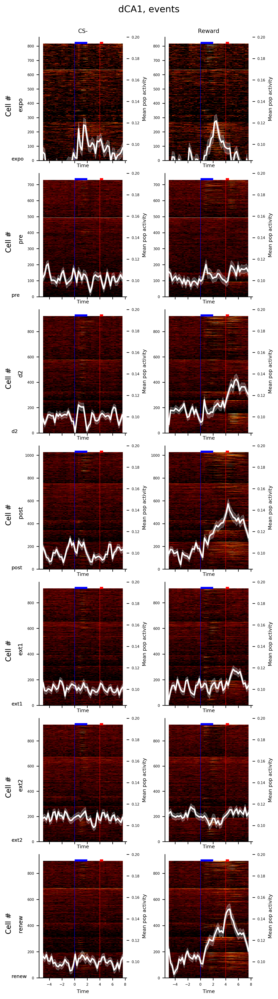

In [44]:
fig, axs = pl.subplots(len(sessions), 2, figsize=(5, np.ceil(all_hms_pre_CSm_evs.shape[0]/40.)), sharex=True)
for sess,i in zip(sessions,range(len(sessions))):
    for tt,z in zip(['CSm','Rew'],range(2)):
        func = lambda x, y: x.imshow(y, aspect='auto', extent=(eval("min_time_ax_single_%s[0]"%sess), eval("min_time_ax_single_%s[-1]"%sess), 0, 
                                 len(eval("all_hms_%s_%s_evs"%(sess,tt)))),vmin=0, vmax=1, cmap='afmhot')

        func(axs[i][z], eval("all_hms_%s_%s_evs"%(sess,tt)))
        axs[i][0].text(-10,0, sess, fontsize=7)
        axs[i][z].set_xlabel("Time")
        axs[i][z].vlines([0, 4], 0, len(eval("all_hms_%s_CSm_evs"%sess)), color=['b','r'], lw=.5)
        axs[i][z].hlines(len(eval("all_hms_%s_CSm_evs"%sess))+5, 0, 2, color='b', lw=3)
        axs[i][z].hlines(len(eval("all_hms_%s_CSm_evs"%sess))+5, 4, 4.5, color='r', lw=3)
        axs[i][0].text(-9,len(eval("all_hms_%s_CSm_evs"%sess))/2, sess, fontsize=8, rotation=90)
        axs[i][0].text(-11,len(eval("all_hms_%s_CSm_evs"%sess))/2+10, "Cell #", fontsize=10, rotation=90)
        twin_ax = axs[i][z].twinx()
        twin_ax.set_ylabel("Mean pop activity")
        twin_ax.plot(eval("min_time_ax_single_%s"%sess),eval("all_hms_%s_%s_evs.mean(0)"%(sess,tt)),color='w',lw=2)
        m = eval("all_hms_%s_%s_evs.mean(0)"%(sess,tt))
        sem = eval("all_hms_%s_%s_evs.std(0)/(math.sqrt(len(all_hms_%s_%s_evs)))"%(sess,tt,sess,tt))
        twin_ax.fill_between(eval("min_time_ax_single_%s"%sess),m-sem,m+sem,alpha=0.25,color='w',linewidth=1)
        twin_ax.set_ylim(0.085,.2)

# axs[0][0].imshow(all_hms_pre1[sort_pre1], aspect='auto', extent=(time_ax_single[0], time_ax_single[-1], 0, len(sort_pre1)),
#                  vmin=0, vmax=1)
#for ax in axs.flatten():
#    #pt.remove_axes(ax)
#    ax.tick_params(
#    axis='x',          # changes apply to the x-axis
#    which='both',      # both major and minor ticks are affected
#    bottom=False,      # ticks along the bottom edge are off
#    top=False,         # ticks along the top edge are off
#    labelbottom=False) # labels along the bottom edge are off
    #ax.vlines([0, 4], 0, len(sort_pre_CSm), color='b', lw=.5)

axs[0][0].set_title('CS-', fontsize=8)
axs[0][1].set_title('Reward', fontsize=8)

fig.suptitle("dCA1, events", fontsize=13, y=1.02)
fig.tight_layout()
fig.savefig('../img/%s_event_heatmaps.jpg'%(NOTEBOOK_NAME))

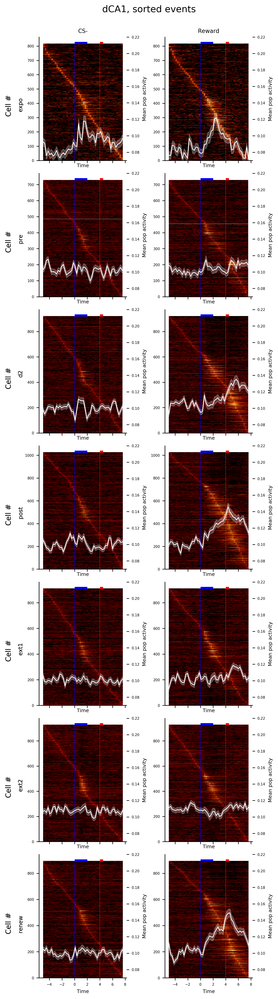

In [45]:
fig, axs = pl.subplots(len(sessions), 2, figsize=(5, np.ceil(all_hms_pre_CSm_evs.shape[0]/40.)), sharex=True)
for sess,i in zip(sessions,range(len(sessions))):
    for tt,z in zip(['CSm','Rew'],range(2)):
        func = lambda x, y: x.imshow(y, aspect='auto', extent=(eval("min_time_ax_single_%s[0]"%sess), eval("min_time_ax_single_%s[-1]"%sess), 0, 
                                 len(eval("all_hms_%s_%s_evs"%(sess,tt)))),vmin=0, vmax=1, cmap='afmhot')

        func(axs[i][z], eval("all_hms_%s_%s_evs[sort_%s_%s_evs]"%(sess,tt,sess,tt)))
        #axs[i][0].text(-10,0, sess, fontsize=7)
        axs[i][z].set_xlabel("Time")
        axs[i][z].vlines([0, 4], 0, len(eval("all_hms_%s_CSm_evs"%sess)), color=['b','r'], lw=.5)
        axs[i][z].hlines(len(eval("all_hms_%s_CSm_evs"%sess))+5, 0, 2, color='b', lw=3)
        axs[i][z].hlines(len(eval("all_hms_%s_CSm_evs"%sess))+5, 4, 4.5, color='r', lw=3)
        axs[i][0].text(-9,len(eval("all_hms_%s_CSm_evs"%sess))/2, sess, fontsize=8, rotation=90)
        axs[i][0].text(-11,len(eval("all_hms_%s_CSm_evs"%sess))/2+10, "Cell #", fontsize=10, rotation=90)
        twin_ax = axs[i][z].twinx()
        twin_ax.set_ylabel("Mean pop activity")
        twin_ax.plot(eval("min_time_ax_single_%s"%sess),eval("all_hms_%s_%s_evs.mean(0)"%(sess,tt)),color='w',lw=1)
        m = eval("all_hms_%s_%s_evs.mean(0)"%(sess,tt))
        sem = eval("all_hms_%s_%s_evs.std(0)/(math.sqrt(len(all_hms_%s_%s_evs)))"%(sess,tt,sess,tt))
        twin_ax.fill_between(eval("min_time_ax_single_%s"%sess),m-sem,m+sem,alpha=0.25,color='w',linewidth=1)
        twin_ax.set_ylim(0.07,.22)

# axs[0][0].imshow(all_hms_pre1[sort_pre1], aspect='auto', extent=(time_ax_single[0], time_ax_single[-1], 0, len(sort_pre1)),
#                  vmin=0, vmax=1)
#for ax in axs.flatten():
#    #pt.remove_axes(ax)
#    ax.tick_params(
#    axis='x',          # changes apply to the x-axis
#    which='both',      # both major and minor ticks are affected
#    bottom=False,      # ticks along the bottom edge are off
#    top=False,         # ticks along the top edge are off
#    labelbottom=False) # labels along the bottom edge are off
    #ax.vlines([0, 4], 0, len(sort_pre_CSm), color='b', lw=.5)

axs[0][0].set_title('CS-', fontsize=8)
axs[0][1].set_title('Reward', fontsize=8)

fig.suptitle("dCA1, sorted events", fontsize=13, y=1.02)
fig.tight_layout()
fig.savefig('../final-ish figures/%s_sorted_event_heatmaps.pdf'%(NOTEBOOK_NAME))

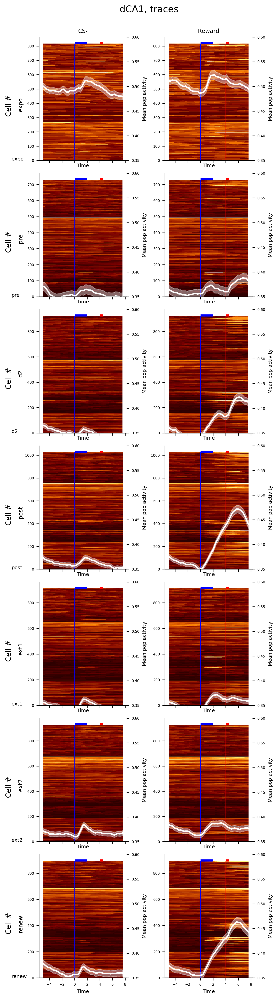

In [46]:
fig, axs = pl.subplots(len(sessions), 2, figsize=(5, np.ceil(all_hms_pre_CSm_traces.shape[0]/40.)), sharex=True)
for sess,i in zip(sessions,range(len(sessions))):
    for tt,z in zip(['CSm','Rew'],range(2)):
        func = lambda x, y: x.imshow(y, aspect='auto', extent=(eval("min_time_ax_single_%s[0]"%sess), eval("min_time_ax_single_%s[-1]"%sess), 0, 
                                 len(eval("all_hms_%s_%s_traces"%(sess,tt)))),vmin=0, vmax=1.5, cmap='afmhot')

        func(axs[i][z], eval("all_hms_%s_%s_traces"%(sess,tt)))
        axs[i][0].text(-10,0, sess, fontsize=7)
        axs[i][z].set_xlabel("Time")
        axs[i][z].vlines([0, 4], 0, len(eval("all_hms_%s_CSm_traces"%sess)), color=['b','r'], lw=.5)
        axs[i][z].hlines(len(eval("all_hms_%s_CSm_traces"%sess))+5, 0, 2, color='b', lw=3)
        axs[i][z].hlines(len(eval("all_hms_%s_CSm_traces"%sess))+5, 4, 4.5, color='r', lw=3)
        axs[i][0].text(-9,len(eval("all_hms_%s_CSm_traces"%sess))/2, sess, fontsize=8, rotation=90)
        axs[i][0].text(-11,len(eval("all_hms_%s_CSm_traces"%sess))/2+10, "Cell #", fontsize=10, rotation=90)
        twin_ax = axs[i][z].twinx()
        twin_ax.set_ylabel("Mean pop activity")
        twin_ax.plot(eval("min_time_ax_single_%s"%sess),eval("all_hms_%s_%s_traces.mean(0)"%(sess,tt)),color='w',lw=2)
        m = eval("all_hms_%s_%s_traces.mean(0)"%(sess,tt))
        sem = eval("all_hms_%s_%s_traces.std(0)/(math.sqrt(len(all_hms_%s_%s_traces)))"%(sess,tt,sess,tt))
        twin_ax.fill_between(eval("min_time_ax_single_%s"%sess),m-sem,m+sem,alpha=0.4,color='w',linewidth=1)
        twin_ax.set_ylim(0.35,.6)

# axs[0][0].imshow(all_hms_pre1[sort_pre1], aspect='auto', extent=(time_ax_single[0], time_ax_single[-1], 0, len(sort_pre1)),
#                  vmin=0, vmax=1)
#for ax in axs.flatten():
#    #pt.remove_axes(ax)
#    ax.tick_params(
#    axis='x',          # changes apply to the x-axis
#    which='both',      # both major and minor ticks are affected
#    bottom=False,      # ticks along the bottom edge are off
#    top=False,         # ticks along the top edge are off
#    labelbottom=False) # labels along the bottom edge are off
    #ax.vlines([0, 4], 0, len(sort_pre_CSm), color='b', lw=.5)

axs[0][0].set_title('CS-', fontsize=8)
axs[0][1].set_title('Reward', fontsize=8)

fig.suptitle("dCA1, traces", fontsize=13, y=1.02)
fig.tight_layout()
fig.savefig('../img/%s_traces_heatmaps.jpg'%(NOTEBOOK_NAME))

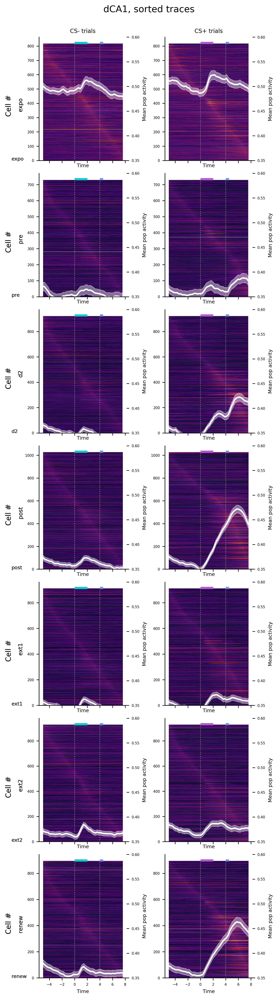

In [16]:
fig, axs = pl.subplots(len(sessions), 2, figsize=(5, np.ceil(all_hms_pre_CSm_traces.shape[0]/40.)), sharex=True)
for sess,i in zip(sessions,range(len(sessions))):
    for tt,z in zip(['CSm','Rew'],range(2)):
        func = lambda x, y: x.imshow(y, aspect='auto', extent=(eval("min_time_ax_single_%s[0]"%sess), eval("min_time_ax_single_%s[-1]"%sess), 0, 
                                 len(eval("all_hms_%s_%s_traces"%(sess,tt)))),vmin=0, vmax=2, cmap='inferno')

        im=func(axs[i][z], eval("all_hms_%s_%s_traces[sort_%s_%s_traces]"%(sess,tt,sess,tt)))
        axs[i][0].text(-10,0, sess, fontsize=7)
        axs[i][z].set_xlabel("Time")
        axs[i][0].vlines([0, 4], 0, len(eval("all_hms_%s_CSm_traces"%sess)), color=['gray','gray'], lw=1, linestyle='dotted')
        axs[i][0].hlines(len(eval("all_hms_%s_CSm_evs"%sess))+5, 0, 2, color='darkturquoise', lw=3)
        axs[i][1].vlines([0, 4], 0, len(eval("all_hms_%s_CSm_traces"%sess)), color=['gray','gray'], lw=1, linestyle='dotted')
        axs[i][1].hlines(len(eval("all_hms_%s_CSm_evs"%sess))+5, 0, 2, color='mediumorchid', lw=3)
        axs[i][z].hlines(len(eval("all_hms_%s_CSm_evs"%sess))+5, 4, 4.5, color='cornflowerblue', lw=3)
        axs[i][0].text(-9,len(eval("all_hms_%s_CSm_traces"%sess))/2, sess, fontsize=8, rotation=90)
        axs[i][0].text(-11,len(eval("all_hms_%s_CSm_traces"%sess))/2+10, "Cell #", fontsize=10, rotation=90)
        twin_ax = axs[i][z].twinx()
        twin_ax.set_ylabel("Mean pop activity")
        twin_ax.plot(eval("min_time_ax_single_%s"%sess),eval("all_hms_%s_%s_traces.mean(0)"%(sess,tt)),color='w',lw=2)
        m = eval("all_hms_%s_%s_traces.mean(0)"%(sess,tt))
        sem = eval("all_hms_%s_%s_traces.std(0)/(math.sqrt(len(all_hms_%s_%s_traces)))"%(sess,tt,sess,tt))
        twin_ax.fill_between(eval("min_time_ax_single_%s"%sess),m-sem,m+sem,alpha=0.4,color='w',linewidth=1)
        twin_ax.set_ylim(0.35,.6)
        #cax = fig.add_axes([1,0.3, 0.01, 0.4])
        #fig.colorbar(im, cax=cax, label='Decoding perf. (%)')

# axs[0][0].imshow(all_hms_pre1[sort_pre1], aspect='auto', extent=(time_ax_single[0], time_ax_single[-1], 0, len(sort_pre1)),
#                  vmin=0, vmax=1)
#for ax in axs.flatten():
#    #pt.remove_axes(ax)
#    ax.tick_params(
#    axis='x',          # changes apply to the x-axis
#    which='both',      # both major and minor ticks are affected
#    bottom=False,      # ticks along the bottom edge are off
#    top=False,         # ticks along the top edge are off
#    labelbottom=False) # labels along the bottom edge are off
    #ax.vlines([0, 4], 0, len(sort_pre_CSm), color='b', lw=.5)

axs[0][0].set_title('CS- trials', fontsize=8)
axs[0][1].set_title('CS+ trials', fontsize=8)


fig.suptitle("dCA1, sorted traces", fontsize=13, y=1.02)
fig.tight_layout()
fig.savefig('../final-ish figures/%s_sorted_traces_heatmaps.pdf'%(NOTEBOOK_NAME))

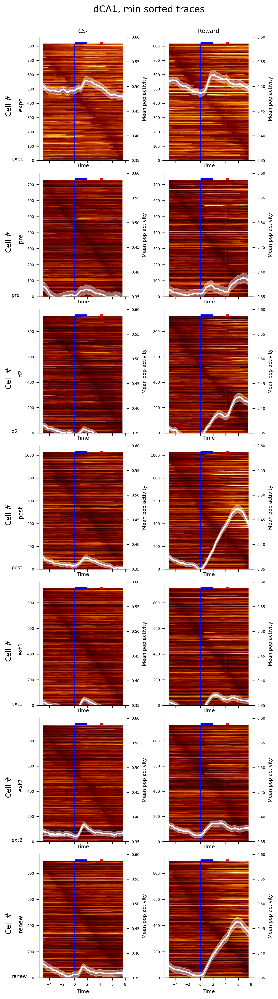

In [357]:
fig, axs = pl.subplots(len(sessions), 2, figsize=(5, np.ceil(all_hms_pre_CSm_traces.shape[0]/40.)), sharex=True)
for sess,i in zip(sessions,range(len(sessions))):
    for tt,z in zip(['CSm','Rew'],range(2)):
        func = lambda x, y: x.imshow(y, aspect='auto', extent=(eval("min_time_ax_single_%s[0]"%sess), eval("min_time_ax_single_%s[-1]"%sess), 0, 
                                 len(eval("all_hms_%s_%s_traces"%(sess,tt)))),vmin=0, vmax=1.5, cmap='afmhot')

        func(axs[i][z], eval("all_hms_%s_%s_traces[minsort_%s_%s_traces]"%(sess,tt,sess,tt)))
        axs[i][0].text(-10,0, sess, fontsize=7)
        axs[i][z].set_xlabel("Time")
        axs[i][z].vlines([0, 4], 0, len(eval("all_hms_%s_CSm_traces"%sess)), color=['b','r'], lw=.5)
        axs[i][z].hlines(len(eval("all_hms_%s_CSm_traces"%sess))+5, 0, 2, color='b', lw=3)
        axs[i][z].hlines(len(eval("all_hms_%s_CSm_traces"%sess))+5, 4, 4.5, color='r', lw=3)
        axs[i][0].text(-9,len(eval("all_hms_%s_CSm_traces"%sess))/2, sess, fontsize=8, rotation=90)
        axs[i][0].text(-11,len(eval("all_hms_%s_CSm_traces"%sess))/2+10, "Cell #", fontsize=10, rotation=90)
        twin_ax = axs[i][z].twinx()
        twin_ax.set_ylabel("Mean pop activity")
        twin_ax.plot(eval("min_time_ax_single_%s"%sess),eval("all_hms_%s_%s_traces.mean(0)"%(sess,tt)),color='w',lw=2)
        m = eval("all_hms_%s_%s_traces.mean(0)"%(sess,tt))
        sem = eval("all_hms_%s_%s_traces.std(0)/(math.sqrt(len(all_hms_%s_%s_traces)))"%(sess,tt,sess,tt))
        twin_ax.fill_between(eval("min_time_ax_single_%s"%sess),m-sem,m+sem,alpha=0.4,color='w',linewidth=1)
        twin_ax.set_ylim(0.35,.6)

# axs[0][0].imshow(all_hms_pre1[sort_pre1], aspect='auto', extent=(time_ax_single[0], time_ax_single[-1], 0, len(sort_pre1)),
#                  vmin=0, vmax=1)
#for ax in axs.flatten():
#    #pt.remove_axes(ax)
#    ax.tick_params(
#    axis='x',          # changes apply to the x-axis
#    which='both',      # both major and minor ticks are affected
#    bottom=False,      # ticks along the bottom edge are off
#    top=False,         # ticks along the top edge are off
#    labelbottom=False) # labels along the bottom edge are off
    #ax.vlines([0, 4], 0, len(sort_pre_CSm), color='b', lw=.5)

axs[0][0].set_title('CS-', fontsize=8)
axs[0][1].set_title('Reward', fontsize=8)

fig.suptitle("dCA1, min sorted traces", fontsize=13, y=1.02)
fig.tight_layout()
fig.savefig('../final-ish figures/%s_min_sorted_traces_heatmaps.pdf'%(NOTEBOOK_NAME))

In [48]:
##this means nothing w/o cellReg cells
#from scipy import stats as sstats
#
#corrs_CSm = np.r_[[sstats.pearsonr(a1[:min(len(a1), len(a2))], a2[:min(len(a1), len(a2))])[0]
#                 for a1, a2 in zip(all_hms_pre_CSm[sort_pre_CSm], all_hms_post_CSm[sort_pre_CSm])]]
#corrs_Rew = np.r_[[sstats.pearsonr(a1[:min(len(a1), len(a2))], a2[:min(len(a1), len(a2))])[0]
#                 for a1, a2 in zip(all_hms_pre_Rew[sort_pre_Rew], all_hms_post_Rew[sort_pre_Rew])]]
#corrs_Sh = np.r_[[sstats.pearsonr(a1[:min(len(a1), len(a2))], a2[:min(len(a1), len(a2))])[0]
#                 for a1, a2 in zip(all_hms_pre_Sh[sort_pre_Sh], all_hms_post_Sh[sort_pre_Sh])]]
#
#fig, ax = pl.subplots(1, 1, figsize=(2, 1))
#pt.plot_bars([corrs_CSm, corrs_Rew, corrs_Sh], stderr=True, ax=ax)
#pt.add_significance(ax, corrs_CSm, corrs_Rew, 0, 1, 0.2, sig_func=lambda x, y: sstats.kendalltau(x, y))
#pt.nicer_plot(ax)
#ax.set_xticks(range(3))
#ax.set_xticklabels(['CS-', 'Rew', 'Shock'])
#ax.set_ylabel('Tuning correlation\nPRE vs POST')

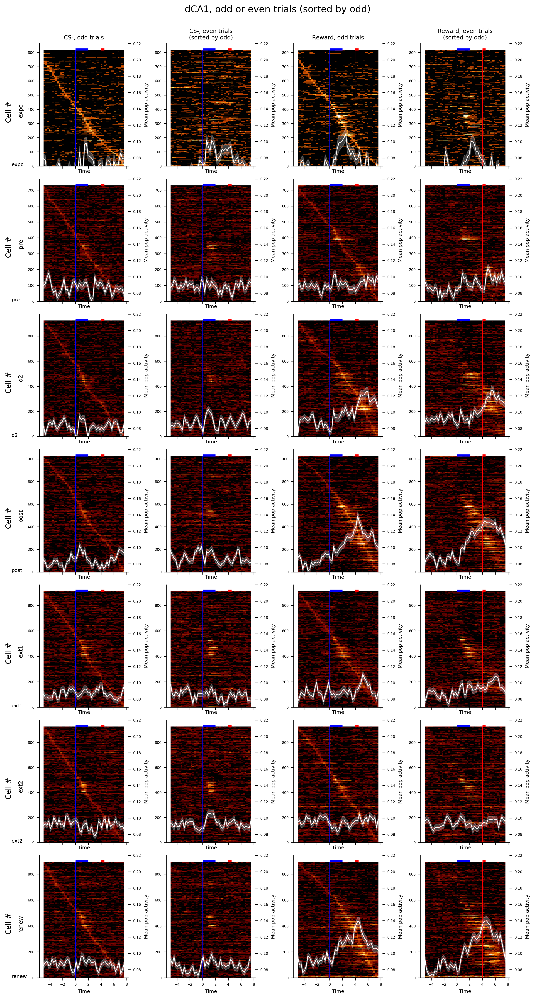

In [49]:
fig, axs = pl.subplots(len(sessions), 4, figsize=(10, np.ceil(all_hms_pre_CSm_evs.shape[0]/40.)), sharex=True)
for sess,i in zip(sessions,range(len(sessions))):
    for tt,eo,z in zip(['CSm','CSm','Rew','Rew'],['odd','even','odd','even'],range(4)):
        func = lambda x, y: x.imshow(y, aspect='auto', extent=(eval("min_time_ax_single_%s[0]"%sess), eval("min_time_ax_single_%s[-1]"%sess), 0, 
                                 len(eval("all_hms_%s_%s_evs"%(sess,tt)))),vmin=0, vmax=1, cmap='afmhot')

        func(axs[i][z], eval("all_hms_%s_%s_evs_%s[sort_%s_%s_evs_odd]"%(sess,tt,eo,sess,tt)))
        axs[i][0].text(-10,0, sess, fontsize=7)
        axs[i][z].set_xlabel("Time")
        axs[i][z].vlines([0, 4], 0, len(eval("all_hms_%s_CSm_evs"%sess)), color=['b','r'], lw=.5)
        axs[i][z].hlines(len(eval("all_hms_%s_CSm_evs"%sess))+5, 0, 2, color='b', lw=3)
        axs[i][z].hlines(len(eval("all_hms_%s_CSm_evs"%sess))+5, 4, 4.5, color='r', lw=3)
        axs[i][0].text(-9,len(eval("all_hms_%s_CSm_evs"%sess))/2, sess, fontsize=8, rotation=90)
        axs[i][0].text(-11,len(eval("all_hms_%s_CSm_evs"%sess))/2+10, "Cell #", fontsize=10, rotation=90)
        twin_ax = axs[i][z].twinx()
        twin_ax.set_ylabel("Mean pop activity")
        twin_ax.plot(eval("min_time_ax_single_%s"%sess),eval("all_hms_%s_%s_evs_%s.mean(0)"%(sess,tt,eo)),color='w',lw=1)
        m = eval("all_hms_%s_%s_evs_%s.mean(0)"%(sess,tt,eo))
        sem = eval("all_hms_%s_%s_evs_%s.std(0)/(math.sqrt(len(all_hms_%s_%s_evs_%s)))"%(sess,tt,eo,sess,tt,eo))
        twin_ax.fill_between(eval("min_time_ax_single_%s"%sess),m-sem,m+sem,alpha=0.25,color='w',linewidth=1)
        twin_ax.set_ylim(0.07,.22)

# axs[0][0].imshow(all_hms_pre1[sort_pre1], aspect='auto', extent=(time_ax_single[0], time_ax_single[-1], 0, len(sort_pre1)),
#                  vmin=0, vmax=1)
#for ax in axs.flatten():
#    #pt.remove_axes(ax)
#    ax.tick_params(
#    axis='x',          # changes apply to the x-axis
#    which='both',      # both major and minor ticks are affected
#    bottom=False,      # ticks along the bottom edge are off
#    top=False,         # ticks along the top edge are off
#    labelbottom=False) # labels along the bottom edge are off
    #ax.vlines([0, 4], 0, len(sort_pre_CSm), color='b', lw=.5)

axs[0][0].set_title('CS-, odd trials', fontsize=8)
axs[0][1].set_title('CS-, even trials\n(sorted by odd)', fontsize=8)
axs[0][2].set_title('Reward, odd trials', fontsize=8)
axs[0][3].set_title('Reward, even trials\n(sorted by odd)', fontsize=8)

fig.suptitle("dCA1, odd or even trials (sorted by odd)", fontsize=13, y=1.02)
fig.tight_layout()
fig.savefig('../final-ish figures/%s_sorted_event_heatmaps_EO.pdf'%(NOTEBOOK_NAME))

# 3rd method for assessing activation width (via Vijay)

in short, take cells sorted by peak activity in odd trials and create a PSTH of activity, centered at the odd peak and +/- 3sec (start with 3 sec). I would do this for all peak timings, for peak timings prior to odor, and cells that peak during the trial (after odor onset). Do this for both events and traces.
How to compare vhpc vs dhpc? Possibilities:

1) take SD of gaussian and compare those (is SD 2x larger for vhpc vs dhpc?)

2) combine data from v and d and do anlaysis and compare to strictly d or v neuron pools

3) shuffle the data with replacement, taking ~70% of cells each iteration. do this 1000 or so times and see how often vhpc width is greater than dhpc (this is monte carlo analysis, no?)

In [ ]:
#first, collect more tbs than are in time_ax_single (that only spans -5 through 8s)

In [184]:
def filter_cycle_JSB(time_ax, cycles, cycle):
    return (time_ax>=cycles[cycle][0]-2.5) * (time_ax<cycles[cycle][1]+3) #since cycles start -5 and end at +8, but imaged from
#-8 to +11ish, can take up to 3 seconds pre to cycle onset and 3 post offset

def compute_all_dffs_JSB(time_ax, dff, cell, cycles, cycle_filter=lambda x: True):
    return np.r_[[dff[:, cell][filter_cycle_JSB(time_ax, cycles, cycle)][:68] #emprically found that 68 seems to be min # of time bins
                              for cycle in range(len(cycles)) if cycle_filter(cycle)]]

In [321]:
#zscored = True

for sess in sessions:
    exec("all_hms_%s_CSm_evs_JSB=[]"%sess)
    exec("all_hms_%s_Rew_evs_JSB=[]"%sess)
    for animal in eval("%s_animals"%sess):
    #    cellregs = anivars[animal]['cellregs']
        exec("vars_%s = %s_anivars['%s']['vars_%s']"%(sess,sess,animal,sess))
    
        for k in eval("vars_%s.keys()"%sess):
            exec('%s = vars_%s[\'%s\']' % (k,sess,k))
    
        exec("hm_%s_CSm_evs_JSB = np.r_[[compute_all_dffs_JSB(time_ax, events, cell, cycles[is_CSmt])\
                        for cell in range(len(vars_%s['events'][0]))]]"%(sess,sess))
        #exec("hm_%s_CSm_evs_JSB = np.r_[[np.mean(h, 0)/np.std(h, 0) if zscored else np.mean(h, 0)/np.max(h.mean(0)) for h in hm_%s_CSm_evs_JSB]]"%(sess,sess))
        exec("hm_%s_CSm_evs_JSB = np.r_[[np.mean(h, 0) for h in hm_%s_CSm_evs_JSB]]"%(sess,sess))
        exec("hm_%s_Rew_evs_JSB = np.r_[[compute_all_dffs_JSB(time_ax, events, cell, cycles[is_rewardt])\
                        for cell in range(len(vars_%s['events'][0]))]]"%(sess,sess))
        #exec("hm_%s_Rew_evs_JSB = np.r_[[np.mean(h, 0)/np.std(h, 0) if zscored else np.mean(h, 0)/np.max(h.mean(0)) for h in hm_%s_Rew_evs_JSB]]"%(sess,sess))
        exec("hm_%s_Rew_evs_JSB = np.r_[[np.mean(h, 0) for h in hm_%s_Rew_evs_JSB]]"%(sess,sess))
        print len(eval("hm_%s_Rew_evs_JSB[0]"%(sess))),

        eval("all_hms_%s_CSm_evs_JSB.append(hm_%s_CSm_evs_JSB)"%(sess, sess))
        eval("all_hms_%s_Rew_evs_JSB.append(hm_%s_Rew_evs_JSB)"%(sess, sess))

68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68


In [323]:
#zscored = True

for sess in sessions:
    exec("all_hms_%s_CSm_traces_JSB=[]"%sess)
    exec("all_hms_%s_Rew_traces_JSB=[]"%sess)
    for animal in eval("%s_animals"%sess):
    #    cellregs = anivars[animal]['cellregs']
        exec("vars_%s = %s_anivars['%s']['vars_%s']"%(sess,sess,animal,sess))
    
        for k in eval("vars_%s.keys()"%sess):
            exec('%s = vars_%s[\'%s\']' % (k,sess,k))
    
        exec("hm_%s_CSm_traces = np.r_[[compute_all_dffs_JSB(time_ax, traces, cell, cycles[is_CSmt])\
                        for cell in range(len(vars_%s['traces'][0]))]]"%(sess,sess))
        #exec("hm_%s_CSm_traces = np.r_[[np.mean(h, 0)/np.std(h, 0) if zscored else np.mean(h, 0)/np.max(h.mean(0)) for h in hm_%s_CSm_traces]]"%(sess,sess))
        exec("hm_%s_CSm_traces = np.r_[[np.mean(h, 0) for h in hm_%s_CSm_traces]]"%(sess,sess))
        exec("hm_%s_Rew_traces = np.r_[[compute_all_dffs_JSB(time_ax, traces, cell, cycles[is_rewardt])\
                        for cell in range(len(vars_%s['traces'][0]))]]"%(sess,sess))
        #exec("hm_%s_Rew_traces = np.r_[[np.mean(h, 0)/np.std(h, 0) if zscored else np.mean(h, 0)/np.max(h.mean(0)) for h in hm_%s_Rew_traces]]"%(sess,sess))
        exec("hm_%s_Rew_traces = np.r_[[np.mean(h, 0) for h in hm_%s_Rew_traces]]"%(sess,sess))
        print len(eval("hm_%s_Rew_traces[0]"%(sess))),
        eval("all_hms_%s_CSm_traces_JSB.append(hm_%s_CSm_traces)"%(sess, sess))
        eval("all_hms_%s_Rew_traces_JSB.append(hm_%s_Rew_traces)"%(sess, sess))

68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68


In [324]:
#zscored = True

for sess in sessions:
    exec("all_hms_%s_CSm_evs_even_JSB=[]"%sess)
    exec("all_hms_%s_Rew_evs_even_JSB=[]"%sess)
    exec("all_hms_%s_CSm_evs_odd_JSB=[]"%sess)
    exec("all_hms_%s_Rew_evs_odd_JSB=[]"%sess)
    for animal in eval("%s_animals"%sess):
    #    cellregs = anivars[animal]['cellregs']
        exec("vars_%s = %s_anivars['%s']['vars_%s']"%(sess,sess,animal,sess))
    
        for k in eval("vars_%s.keys()"%sess):
            exec('%s = vars_%s[\'%s\']' % (k,sess,k))
        
        for eo in 'even','odd':
            exec("hm_%s_CSm_evs_JSB = np.r_[[compute_all_dffs_JSB(time_ax, events, cell, cycles[is_CSmt_%s_%s_%s])\
                            for cell in range(len(vars_%s['events'][0]))]]"%(sess,eo,sess,animal,sess))
            #exec("hm_%s_CSm_evs_JSB = np.r_[[np.mean(h, 0)/np.std(h, 0) if zscored else np.mean(h, 0)/np.max(h.mean(0)) for h in hm_%s_CSm_evs_JSB]]"%(sess,sess))
            exec("hm_%s_CSm_evs_JSB = np.r_[[np.mean(h, 0) for h in hm_%s_CSm_evs_JSB]]"%(sess,sess))
            exec("hm_%s_Rew_evs_JSB = np.r_[[compute_all_dffs_JSB(time_ax, events, cell, cycles[is_rewardt_%s_%s_%s])\
                            for cell in range(len(vars_%s['events'][0]))]]"%(sess,eo,sess,animal,sess))
            #exec("hm_%s_Rew_evs_JSB = np.r_[[np.mean(h, 0)/np.std(h, 0) if zscored else np.mean(h, 0)/np.max(h.mean(0)) for h in hm_%s_Rew_evs_JSB]]"%(sess,sess))
            exec("hm_%s_Rew_evs_JSB = np.r_[[np.mean(h, 0) for h in hm_%s_Rew_evs_JSB]]"%(sess,sess))
            print len(eval("hm_%s_Rew_evs_JSB[0]"%(sess))),

            eval("all_hms_%s_CSm_evs_%s_JSB.append(hm_%s_CSm_evs_JSB)"%(sess,eo,sess))
            eval("all_hms_%s_Rew_evs_%s_JSB.append(hm_%s_Rew_evs_JSB)"%(sess,eo,sess))

68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68


In [325]:
#zscored = True

for sess in sessions:
    exec("all_hms_%s_CSm_traces_even_JSB=[]"%sess)
    exec("all_hms_%s_Rew_traces_even_JSB=[]"%sess)
    exec("all_hms_%s_CSm_traces_odd_JSB=[]"%sess)
    exec("all_hms_%s_Rew_traces_odd_JSB=[]"%sess)
    for animal in eval("%s_animals"%sess):
    #    cellregs = anivars[animal]['cellregs']
        exec("vars_%s = %s_anivars['%s']['vars_%s']"%(sess,sess,animal,sess))
    
        for k in eval("vars_%s.keys()"%sess):
            exec('%s = vars_%s[\'%s\']' % (k,sess,k))
    
        for eo in 'even','odd':
            exec("hm_%s_CSm_traces = np.r_[[compute_all_dffs_JSB(time_ax, traces, cell, cycles[is_CSmt_%s_%s_%s])\
                            for cell in range(len(vars_%s['traces'][0]))]]"%(sess,eo,sess,animal,sess))
            #exec("hm_%s_CSm_traces = np.r_[[np.mean(h, 0)/np.std(h, 0) if zscored else np.mean(h, 0)/np.max(h.mean(0)) for h in hm_%s_CSm_traces]]"%(sess,sess))
            exec("hm_%s_CSm_traces = np.r_[[np.mean(h, 0) for h in hm_%s_CSm_traces]]"%(sess,sess))
            exec("hm_%s_Rew_traces = np.r_[[compute_all_dffs_JSB(time_ax, traces, cell, cycles[is_rewardt_%s_%s_%s])\
                            for cell in range(len(vars_%s['traces'][0]))]]"%(sess,eo,sess,animal,sess))
            #exec("hm_%s_Rew_traces = np.r_[[np.mean(h, 0)/np.std(h, 0) if zscored else np.mean(h, 0)/np.max(h.mean(0)) for h in hm_%s_Rew_traces]]"%(sess,sess))
            exec("hm_%s_Rew_traces = np.r_[[np.mean(h, 0) for h in hm_%s_Rew_traces]]"%(sess,sess))
            print len(eval("hm_%s_Rew_traces[0]"%(sess))),
            
            eval("all_hms_%s_CSm_traces_%s_JSB.append(hm_%s_CSm_traces)"%(sess,eo,sess))
            eval("all_hms_%s_Rew_traces_%s_JSB.append(hm_%s_Rew_traces)"%(sess,eo,sess))

68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68


In [326]:
for sess in sessions:
    for trialtype in ('CSm','Rew'):
        exec("max_t_JSB = np.min([a.shape[1] for a in all_hms_%s_%s_traces_JSB])"%(sess,trialtype))
        exec("all_hms_%s_%s_evs_JSB = np.row_stack([a[:, :max_t_JSB] for a in all_hms_%s_%s_evs_JSB])"%(sess,trialtype,sess,trialtype))
        exec("all_hms_%s_%s_traces_JSB = np.row_stack([a[:, :max_t_JSB] for a in all_hms_%s_%s_traces_JSB])"%(sess,trialtype,sess,trialtype))
        #exec("min_time_ax_single_%s_JSB = (vars_%s['time_ax_single']+9)[:max_t_JSB]"%(sess,sess))
        for eo in 'even','odd':
            exec("all_hms_%s_%s_evs_%s_JSB = np.row_stack([a[:, :max_t_JSB] for a in all_hms_%s_%s_evs_%s_JSB])"%(sess,trialtype,eo,sess,trialtype,eo))
            exec("all_hms_%s_%s_traces_%s_JSB = np.row_stack([a[:, :max_t_JSB] for a in all_hms_%s_%s_traces_%s_JSB])"%(sess,trialtype,eo,sess,trialtype,eo))
    print max_t_JSB

68
68
68
68
68
68
68


In [327]:
#convert nan to 0
for sess in sessions:
    for tt in ('CSm','Rew'):
        exec("all_hms_%s_%s_evs_JSB[np.isnan(all_hms_%s_%s_evs_JSB)]=0"%(sess,tt,sess,tt))
        exec("all_hms_%s_%s_traces_JSB[np.isnan(all_hms_%s_%s_traces_JSB)]=0"%(sess,tt,sess,tt))

In [328]:
for sess in sessions:
    for trialtype in ('CSm','Rew'):
        exec("sort_%s_%s_evs_JSB = np.argsort([np.argmax(h) for h in all_hms_%s_%s_evs_JSB])"%(sess,trialtype,sess,trialtype))
        exec("minsort_%s_%s_evs_JSB = np.argsort([np.argmin(h) for h in all_hms_%s_%s_evs_JSB])"%(sess,trialtype,sess,trialtype))
        exec("sort_%s_%s_traces_JSB = np.argsort([np.argmax(h) for h in all_hms_%s_%s_traces_JSB])"%(sess,trialtype,sess,trialtype))
        exec("minsort_%s_%s_traces_JSB = np.argsort([np.argmin(h) for h in all_hms_%s_%s_traces_JSB])"%(sess,trialtype,sess,trialtype))

In [329]:
#convert nan to 0
for sess in sessions:
    for tt in ('CSm','Rew'):
        for trl in ('even','odd'):
            exec("all_hms_%s_%s_evs_%s_JSB[np.isnan(all_hms_%s_%s_evs_%s_JSB)]=0"%(sess,tt,trl,sess,tt,trl))
            exec("all_hms_%s_%s_traces_%s_JSB[np.isnan(all_hms_%s_%s_traces_%s_JSB)]=0"%(sess,tt,trl,sess,tt,trl))

In [330]:
for sess in sessions:
    for trialtype in ('CSm','Rew'):
        exec("sort_%s_%s_evs_even_JSB = np.argsort([np.argmax(h) for h in all_hms_%s_%s_evs_even_JSB])"%(sess,trialtype,sess,trialtype))
        exec("sort_%s_%s_traces_even_JSB = np.argsort([np.argmax(h) for h in all_hms_%s_%s_traces_even_JSB])"%(sess,trialtype,sess,trialtype))
        exec("sort_%s_%s_evs_odd_JSB = np.argsort([np.argmax(h) for h in all_hms_%s_%s_evs_odd_JSB])"%(sess,trialtype,sess,trialtype))
        exec("sort_%s_%s_traces_odd_JSB = np.argsort([np.argmax(h) for h in all_hms_%s_%s_traces_odd_JSB])"%(sess,trialtype,sess,trialtype))

pre_tbs=15 #how many time bins to examine prior to peak?
post_tbs=15
for sess in sessions:
    for tt in 'CSm','Rew':
        exec("odd_peak_even_PETH_%s_%s_evs = []"%(sess,tt))
        for cell,i in zip(eval("all_hms_%s_%s_evs_odd"%(sess,tt)), range(len(eval("all_hms_%s_%s_evs_odd"%(sess,tt))))):
            x = np.where(cell == np.max(cell))
            ## exclue peaks that do not have enough time bins to collect
            if x[0][0]>pre_tbs:
                if x[0][0] < 68-post_tbs: #68 = total number of time bins
                    print x[0][0],
                    exec("odd_peak_even_PETH_%s_%s_evs.append(all_hms_%s_%s_evs_even[i][x[0][0]-pre_tbs:x[0][0]+post_tbs+1])"%(sess,tt,sess,tt))

#next break up into where max is during baseline (tb 31 or before) or trial (>tb33).
#and need to include tb buffer before and after to make sure the data are present

In [331]:
pre_tbs=15 #how many time bins to examine prior to peak?
post_tbs=15
for sess in sessions:
    for tt in 'CSm','Rew':
        for signal in 'evs','traces':
            exec("odd_peak_even_PETH_%s_%s_%s = []"%(sess,tt,signal))
            for cell,i in zip(eval("all_hms_%s_%s_%s_odd_JSB"%(sess,tt,signal)), range(len(eval("all_hms_%s_%s_%s_odd_JSB"%(sess,tt,signal))))):
                x = np.where(cell == np.max(cell))
                ## exclue peaks that do not have enough time bins to collect
                if x[0][0]>=pre_tbs:
                    if x[0][0] < 68-post_tbs: #68 = total number of time bins
                        #print x[0][0],
                        exec("odd_peak_even_PETH_%s_%s_%s.append(all_hms_%s_%s_%s_even_JSB[i][x[0][0]-pre_tbs:x[0][0]+post_tbs+1])"%(sess,tt,signal,sess,tt,signal))

In [343]:
#next break up into where max is during baseline (tb 31 or before) or during odor-trace period (roughly).
pre_tbs=15 #how many time bins to examine prior to peak?
post_tbs=15
for sess in sessions:
    for tt in 'CSm','Rew':
        for signal in 'evs','traces':
            exec("odd_peak_even_PETH_%s_%s_%s_baseline = []"%(sess,tt,signal))
            exec("odd_peak_even_PETH_%s_%s_%s_trial = []"%(sess,tt,signal))
            for cell,i in zip(eval("all_hms_%s_%s_%s_odd_JSB"%(sess,tt,signal)), range(len(eval("all_hms_%s_%s_%s_odd_JSB"%(sess,tt,signal))))):
                x = np.where(cell == np.max(cell))
                ## exclue peaks that do not have enough time bins to collect
                if x[0][0]>=pre_tbs:
                    if x[0][0] < 68-post_tbs: #68 = total number of time bins
                        #print x[0][0],
                        if x[0][0]<31:
                            #normalize even amplitude wrt peak odd amplitude
                            exec("odd_peak_even_PETH_%s_%s_%s_baseline.append(all_hms_%s_%s_%s_even_JSB[i][x[0][0]-pre_tbs:x[0][0]+post_tbs+1])"%(sess,tt,signal,sess,tt,signal))
                        if x[0][0]>34:
                            if x[0][0]<50:
                                exec("odd_peak_even_PETH_%s_%s_%s_trial.append(all_hms_%s_%s_%s_even_JSB[i][x[0][0]-pre_tbs:x[0][0]+post_tbs+1])"%(sess,tt,signal,sess,tt,signal))

In [346]:
#next break up into where max is during baseline (tb 31 or before) or during odor-trace period (roughly).
#NORMALIZE EVEN ACTIVITY TO PEAK ODD ACTIVITY
pre_tbs=15 #how many time bins to examine prior to peak?
post_tbs=15
for sess in sessions:
    for tt in 'CSm','Rew':
        for signal in 'evs','traces':
            exec("odd_peak_even_PETH_%s_%s_%s_baseline_normed = []"%(sess,tt,signal))
            exec("odd_peak_even_PETH_%s_%s_%s_trial_normed = []"%(sess,tt,signal))
            for cell,i in zip(eval("all_hms_%s_%s_%s_odd_JSB"%(sess,tt,signal)), range(len(eval("all_hms_%s_%s_%s_odd_JSB"%(sess,tt,signal))))):
                x = np.where(cell == np.max(cell))
                ## exclue peaks that do not have enough time bins to collect
                if x[0][0]>=pre_tbs:
                    if x[0][0] < 68-post_tbs: #68 = total number of time bins
                        #print x[0][0],
                        if x[0][0]<31:
                            #normalize even amplitude wrt peak odd amplitude
                            exec("odd_peak_even_PETH_%s_%s_%s_baseline_normed.append(all_hms_%s_%s_%s_even_JSB[i][x[0][0]-pre_tbs:x[0][0]+post_tbs+1]\
                                  /cell[x])"%(sess,tt,signal,sess,tt,signal))
                        if x[0][0]>34:
                            if x[0][0]<50:
                                exec("odd_peak_even_PETH_%s_%s_%s_trial_normed.append(all_hms_%s_%s_%s_even_JSB[i][x[0][0]-pre_tbs:x[0][0]+post_tbs+1]\
                                      /cell[x])"%(sess,tt,signal,sess,tt,signal))

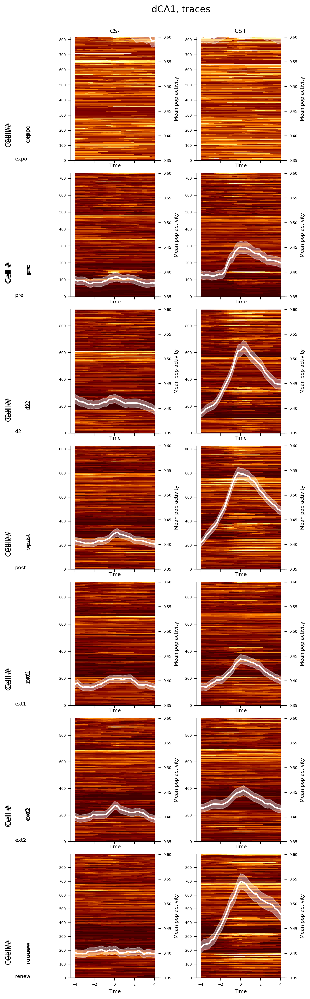

In [276]:
Xs = list(np.linspace(-4,4,31))
fig, axs = pl.subplots(len(sessions), 2, figsize=(5, np.ceil(all_hms_pre_CSm_traces.shape[0]/40.)), sharex=True)
for sess,i in zip(sessions,range(len(sessions))):
    for tt,z in zip(['CSm','Rew'],range(2)):
        func = lambda x, y: x.imshow(y, aspect='auto', extent=(-4, 4, 0, len(eval("all_hms_%s_%s_traces"%(sess,tt)))),
                                     vmin=0, vmax=1.5, cmap='afmhot')

        func(axs[i][z], eval("odd_peak_even_PETH_%s_%s_traces"%(sess,tt)))
        axs[i][0].text(-10,0, sess, fontsize=7)
        axs[i][z].set_xlabel("Time")
        axs[i][0].text(-9,len(eval("odd_peak_even_PETH_%s_%s_traces"%(sess,tt)))/2, sess, fontsize=8, rotation=90)
        axs[i][0].text(-11,len(eval("odd_peak_even_PETH_%s_%s_traces"%(sess,tt)))/2+10, "Cell #", fontsize=10, rotation=90)
        twin_ax = axs[i][z].twinx()
        twin_ax.set_ylabel("Mean pop activity")
        m = list(np.mean(eval("odd_peak_even_PETH_%s_%s_traces"%(sess,tt)),0))
        sem = np.std(eval("odd_peak_even_PETH_%s_%s_traces"%(sess,tt)),0)/(math.sqrt(len(eval("odd_peak_even_PETH_%s_%s_traces"%(sess,tt)))))
        twin_ax.fill_between(Xs,m-sem,m+sem,alpha=0.4,color='w',linewidth=1)
        twin_ax.plot(Xs,m,color='w',lw=2)
        twin_ax.set_ylim(0.35,.6)

# axs[0][0].imshow(all_hms_pre1[sort_pre1], aspect='auto', extent=(time_ax_single[0], time_ax_single[-1], 0, len(sort_pre1)),
#                  vmin=0, vmax=1)
#for ax in axs.flatten():
#    #pt.remove_axes(ax)
#    ax.tick_params(
#    axis='x',          # changes apply to the x-axis
#    which='both',      # both major and minor ticks are affected
#    bottom=False,      # ticks along the bottom edge are off
#    top=False,         # ticks along the top edge are off
#    labelbottom=False) # labels along the bottom edge are off
    #ax.vlines([0, 4], 0, len(sort_pre_CSm), color='b', lw=.5)

axs[0][0].set_title('CS-', fontsize=8)
axs[0][1].set_title('CS+', fontsize=8)

fig.suptitle("dCA1, traces", fontsize=13, y=1.02)
fig.tight_layout()
#fig.savefig('../img/%s_traces_heatmaps.jpg'%(NOTEBOOK_NAME))

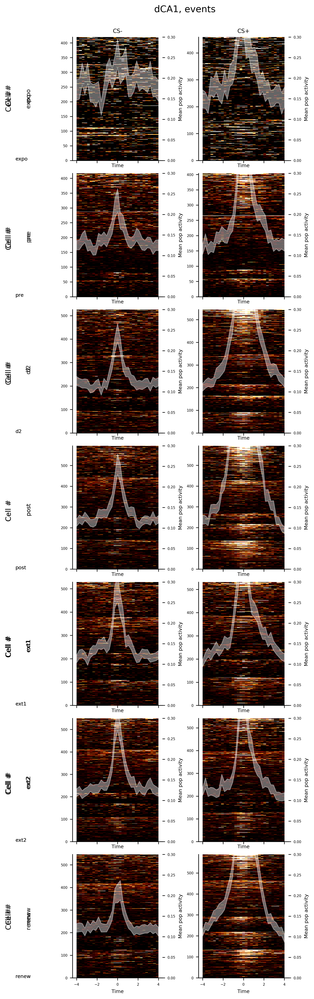

In [352]:
Xs = list(np.linspace(-4,4,31))
fig, axs = pl.subplots(len(sessions), 2, figsize=(5, np.ceil(all_hms_pre_CSm_evs.shape[0]/40.)), sharex=True)
for sess,i in zip(sessions,range(len(sessions))):
    for tt,z in zip(['CSm','Rew'],range(2)):
        func = lambda x, y: x.imshow(y, aspect='auto', extent=(-4, 4, 0, len(eval("odd_peak_even_PETH_%s_%s_evs"%(sess,tt)))),
                                     vmin=0, vmax=1.5, cmap='afmhot')

        func(axs[i][z], eval("odd_peak_even_PETH_%s_%s_evs"%(sess,tt)))
        axs[i][0].text(-10,0, sess, fontsize=7)
        axs[i][z].set_xlabel("Time")
        axs[i][0].text(-9,len(eval("odd_peak_even_PETH_%s_%s_evs"%(sess,tt)))/2, sess, fontsize=8, rotation=90)
        axs[i][0].text(-11,len(eval("odd_peak_even_PETH_%s_%s_evs"%(sess,tt)))/2+10, "Cell #", fontsize=10, rotation=90)
        twin_ax = axs[i][z].twinx()
        twin_ax.set_ylabel("Mean pop activity")
        m = list(np.mean(eval("odd_peak_even_PETH_%s_%s_evs"%(sess,tt)),0))
        sem = np.std(eval("odd_peak_even_PETH_%s_%s_evs"%(sess,tt)),0)/(math.sqrt(len(eval("odd_peak_even_PETH_%s_%s_evs"%(sess,tt)))))
        twin_ax.fill_between(Xs,m-sem,m+sem,alpha=0.4,color='w',linewidth=1)
        #twin_ax.plot(Xs,m,color='w',lw=2)
        twin_ax.set_ylim(0.,.3)

# axs[0][0].imshow(all_hms_pre1[sort_pre1], aspect='auto', extent=(time_ax_single[0], time_ax_single[-1], 0, len(sort_pre1)),
#                  vmin=0, vmax=1)
#for ax in axs.flatten():
#    #pt.remove_axes(ax)
#    ax.tick_params(
#    axis='x',          # changes apply to the x-axis
#    which='both',      # both major and minor ticks are affected
#    bottom=False,      # ticks along the bottom edge are off
#    top=False,         # ticks along the top edge are off
#    labelbottom=False) # labels along the bottom edge are off
    #ax.vlines([0, 4], 0, len(sort_pre_CSm), color='b', lw=.5)

axs[0][0].set_title('CS-', fontsize=8)
axs[0][1].set_title('CS+', fontsize=8)

fig.suptitle("dCA1, events", fontsize=13, y=1.02)
fig.tight_layout()
#fig.savefig('../img/%s_evs_heatmaps.jpg'%(NOTEBOOK_NAME))

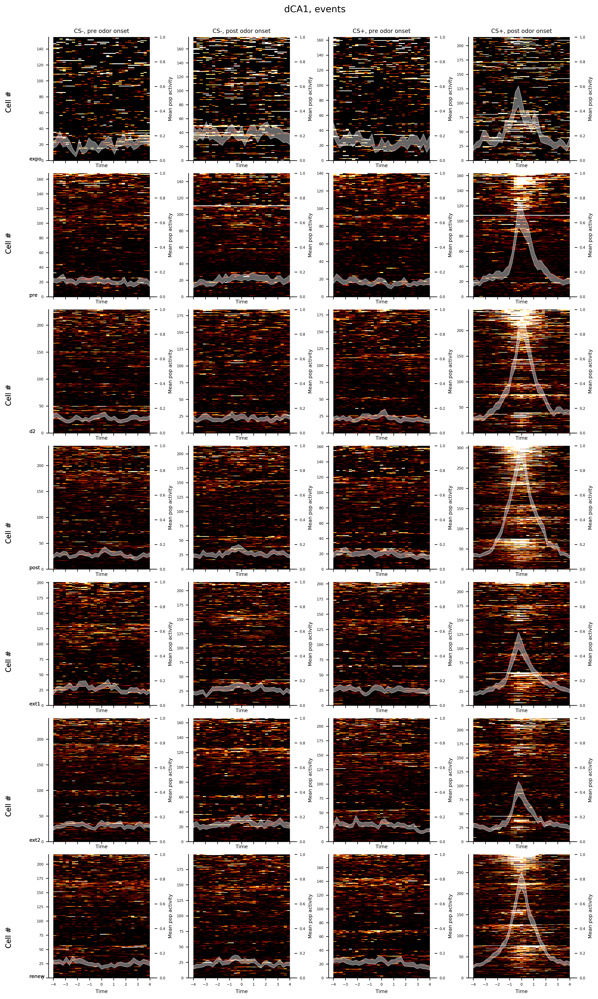

In [353]:
Xs = list(np.linspace(-4,4,31))
fig, axs = pl.subplots(len(sessions), 4, figsize=(11, np.ceil(all_hms_pre_CSm_evs.shape[0]/40.)), sharex=True)
for tt,eo,z in zip(['CSm','CSm','Rew','Rew'],['baseline','trial','baseline','trial'],range(4)):
    for sess,i in zip(sessions,range(len(sessions))):
        func = lambda x, y: x.imshow(y, aspect='auto', extent=(-4, 4, 0, len(eval("odd_peak_even_PETH_%s_%s_evs_%s"%(sess,tt,eo)))),
                                     vmin=0, vmax=1.5, cmap='afmhot')

        func(axs[i][z], eval("odd_peak_even_PETH_%s_%s_evs_%s"%(sess,tt,eo)))
        axs[i][0].text(-6,0, sess, fontsize=7)
        axs[i][z].set_xlabel("Time")
        #axs[i][0].text(-9,len(eval("odd_peak_even_PETH_%s_%s_evs_%s"%(sess,tt,eo)))/2, sess, fontsize=8, rotation=90)
        axs[i][0].text(-8,80, "Cell #", fontsize=10, rotation=90)
        twin_ax = axs[i][z].twinx()
        twin_ax.set_ylabel("Mean pop activity")
        m = list(np.mean(eval("odd_peak_even_PETH_%s_%s_evs_%s"%(sess,tt,eo)),0))
        sem = np.std(eval("odd_peak_even_PETH_%s_%s_evs_%s"%(sess,tt,eo)),0)/(math.sqrt(len(eval("odd_peak_even_PETH_%s_%s_evs_%s"%(sess,tt,eo)))))
        twin_ax.fill_between(Xs,m-sem,m+sem,alpha=0.4,color='w',linewidth=1)
        #twin_ax.plot(Xs,m,color='w',lw=2)
        twin_ax.set_ylim(0.,1)

# axs[0][0].imshow(all_hms_pre1[sort_pre1], aspect='auto', extent=(time_ax_single[0], time_ax_single[-1], 0, len(sort_pre1)),
#                  vmin=0, vmax=1)
#for ax in axs.flatten():
#    #pt.remove_axes(ax)
#    ax.tick_params(
#    axis='x',          # changes apply to the x-axis
#    which='both',      # both major and minor ticks are affected
#    bottom=False,      # ticks along the bottom edge are off
#    top=False,         # ticks along the top edge are off
#    labelbottom=False) # labels along the bottom edge are off
    #ax.vlines([0, 4], 0, len(sort_pre_CSm), color='b', lw=.5)

axs[0][0].set_title('CS-, pre odor onset', fontsize=8)
axs[0][1].set_title('CS-, post odor onset', fontsize=8)
axs[0][2].set_title('CS+, pre odor onset', fontsize=8)
axs[0][3].set_title('CS+, post odor onset', fontsize=8)

fig.suptitle("dCA1, events", fontsize=13, y=1.02)
fig.tight_layout()
#fig.savefig('../img/%s_evs_heatmaps.jpg'%(NOTEBOOK_NAME))

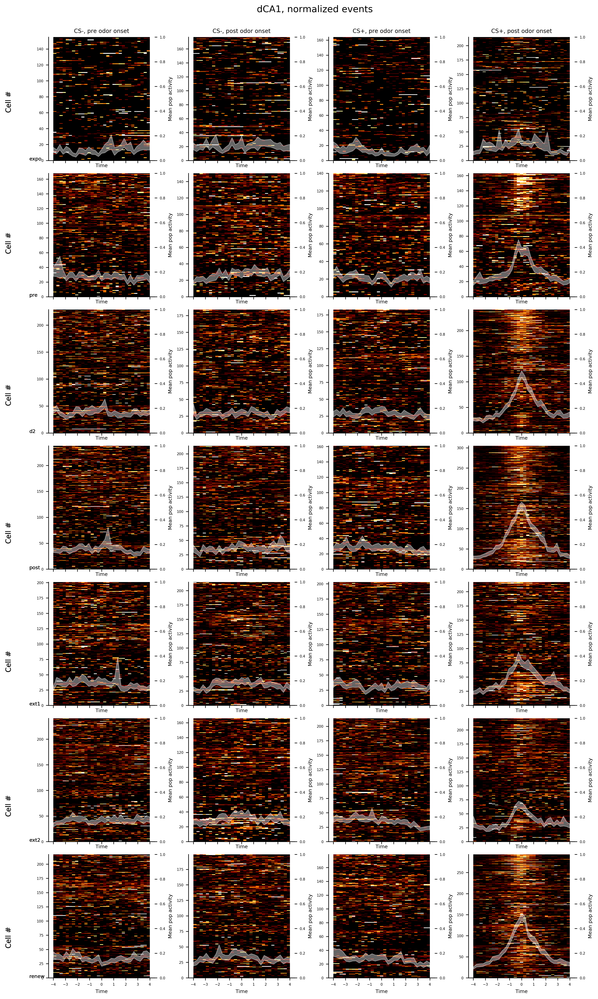

In [354]:
Xs = list(np.linspace(-4,4,31))
fig, axs = pl.subplots(len(sessions), 4, figsize=(11, np.ceil(all_hms_pre_CSm_evs.shape[0]/40.)), sharex=True)
for tt,eo,z in zip(['CSm','CSm','Rew','Rew'],['baseline','trial','baseline','trial'],range(4)):
    for sess,i in zip(sessions,range(len(sessions))):
        func = lambda x, y: x.imshow(y, aspect='auto', extent=(-4, 4, 0, len(eval("odd_peak_even_PETH_%s_%s_evs_%s_normed"%(sess,tt,eo)))),
                                     vmin=0, vmax=1.5, cmap='afmhot')

        func(axs[i][z], eval("odd_peak_even_PETH_%s_%s_evs_%s_normed"%(sess,tt,eo)))
        axs[i][0].text(-6,0, sess, fontsize=7)
        axs[i][z].set_xlabel("Time")
        #axs[i][0].text(-9,len(eval("odd_peak_even_PETH_%s_%s_evs_%s"%(sess,tt,eo)))/2, sess, fontsize=8, rotation=90)
        axs[i][0].text(-8,80, "Cell #", fontsize=10, rotation=90)
        twin_ax = axs[i][z].twinx()
        twin_ax.set_ylabel("Mean pop activity")
        m = list(np.mean(eval("odd_peak_even_PETH_%s_%s_evs_%s_normed"%(sess,tt,eo)),0))
        sem = np.std(eval("odd_peak_even_PETH_%s_%s_evs_%s_normed"%(sess,tt,eo)),0)/(math.sqrt(len(eval("odd_peak_even_PETH_%s_%s_evs_%s_normed"%(sess,tt,eo)))))
        twin_ax.fill_between(Xs,m-sem,m+sem,alpha=0.4,color='w',linewidth=1)
        #twin_ax.plot(Xs,m,color='w',lw=2)
        twin_ax.set_ylim(0.,1)

# axs[0][0].imshow(all_hms_pre1[sort_pre1], aspect='auto', extent=(time_ax_single[0], time_ax_single[-1], 0, len(sort_pre1)),
#                  vmin=0, vmax=1)
#for ax in axs.flatten():
#    #pt.remove_axes(ax)
#    ax.tick_params(
#    axis='x',          # changes apply to the x-axis
#    which='both',      # both major and minor ticks are affected
#    bottom=False,      # ticks along the bottom edge are off
#    top=False,         # ticks along the top edge are off
#    labelbottom=False) # labels along the bottom edge are off
    #ax.vlines([0, 4], 0, len(sort_pre_CSm), color='b', lw=.5)

axs[0][0].set_title('CS-, pre odor onset', fontsize=8)
axs[0][1].set_title('CS-, post odor onset', fontsize=8)
axs[0][2].set_title('CS+, pre odor onset', fontsize=8)
axs[0][3].set_title('CS+, post odor onset', fontsize=8)

fig.suptitle("dCA1, normalized events", fontsize=13, y=1.02)
fig.tight_layout()
#fig.savefig('../img/%s_evs_heatmaps.jpg'%(NOTEBOOK_NAME))

In [355]:
save_workspace(db)

Could not store variable 'sstats'. Skipping...
Could not store variable 'fig'. Skipping...
Could not store variable 'pt'. Skipping...
Could not store variable 'pl'. Skipping...
Could not store variable 'func'. Skipping...
Could not store variable 'di'. Skipping...
Could not store variable 'ip'. Skipping...
Could not store variable 'sys'. Skipping...
Could not store variable 'ut'. Skipping...
Could not store variable 'IPython'. Skipping...
Could not store variable 'pickle'. Skipping...
Could not store variable 'os'. Skipping...
Could not store variable 'math'. Skipping...
Could not store variable 'twin_ax'. Skipping...
Could not store variable 'axs'. Skipping...
Could not store variable 'np'. Skipping...
